In [1]:
import os

dataset_dir = 'bob-ross-dataset'

# Create a list of all paths to the images
image_paths = [os.path.join(dataset_dir, 'images', file) for file in os.listdir(dataset_dir+'/images')]
label_paths = [os.path.join(dataset_dir, 'labels', file) for file in os.listdir(dataset_dir+'/labels')]

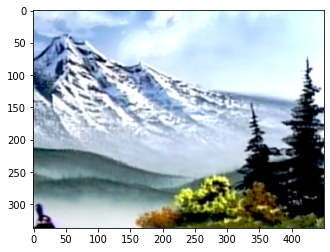

In [2]:
import imageio.v2 as imageio
import matplotlib.pyplot as plt

# Load the image file
img = imageio.imread(image_paths[0])

# Display the image
plt.imshow(img)
plt.show()

In [3]:
import tensorflow as tf
import numpy as np

In [4]:
images = [imageio.imread(path) for path in image_paths if path.endswith('.png')]
labels = [imageio.imread(path) for path in label_paths if path.endswith('.png')]

images = np.array(images)
labels = np.array(labels)

In [5]:
labels[0]

array([[ 3,  3,  3, ...,  3,  3,  3],
       [ 3,  3,  3, ...,  3,  3,  3],
       [ 3,  3,  3, ...,  3,  3,  3],
       ...,
       [ 5,  5,  5, ..., 18, 18, 18],
       [ 5,  5,  5, ..., 18, 18, 18],
       [ 5,  5,  5, ..., 18, 18, 18]], dtype=uint8)

In [6]:
# Convert labels 3, 5, 10, 14, 17, 18, 22, 27, 61 into 0, 2, 3, 4, 5, 6, 7, 8
labels[labels == 3] = 0
labels[labels == 5] = 1
labels[labels == 10] = 2
labels[labels == 14] = 3
labels[labels == 17] = 4
labels[labels == 18] = 5
labels[labels == 22] = 6
labels[labels == 27] = 7
labels[labels == 61] = 8

In [7]:
labels[0]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [1, 1, 1, ..., 5, 5, 5],
       [1, 1, 1, ..., 5, 5, 5],
       [1, 1, 1, ..., 5, 5, 5]], dtype=uint8)

In [8]:
labels.shape

(250, 337, 450)

In [9]:
# Find number of unique labels
len(np.unique(labels))

9

In [10]:
# labels = np.expand_dims(labels, axis=-1)
labels.shape

(250, 337, 450)

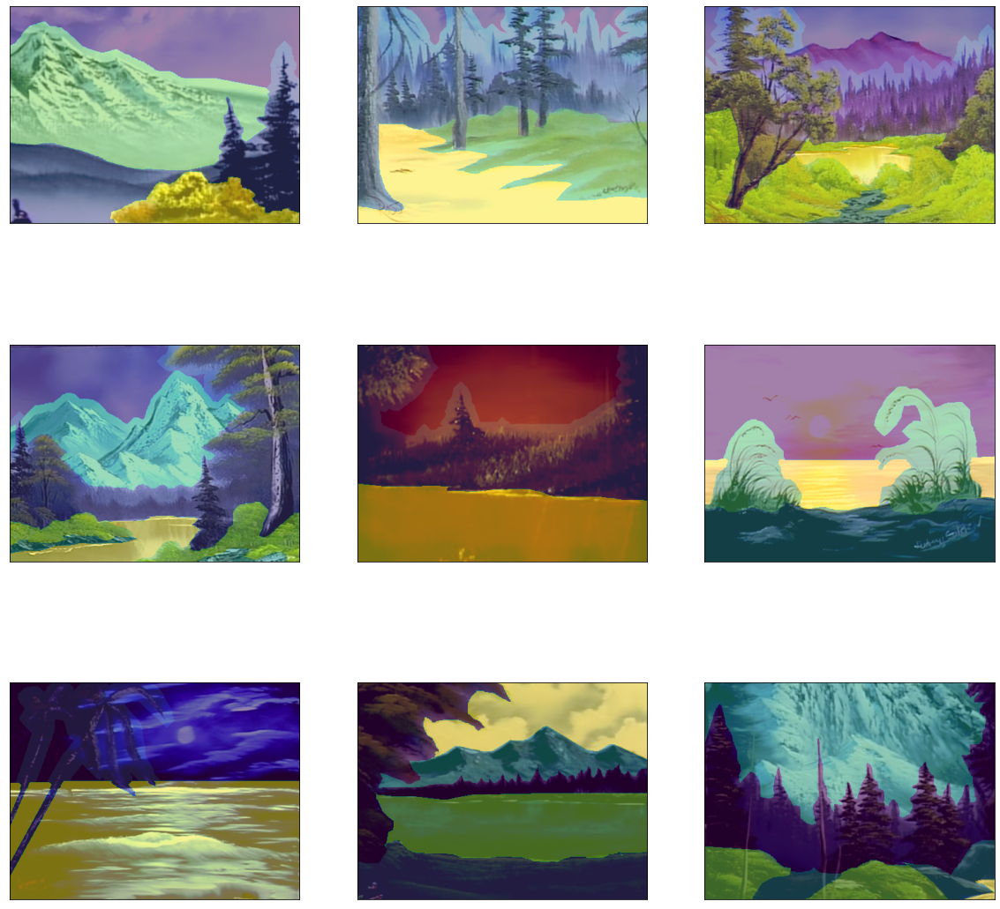

In [11]:
# plot 9 images and their labels overlapping
fig, ax = plt.subplots(3, 3, figsize=(20, 20))
for i, axi in enumerate(ax.flat):
    axi.imshow(images[i])
    axi.imshow(labels[i], alpha=0.5)
    axi.set(xticks=[], yticks=[])
plt.show()

In [12]:
import tensorflow as tf

# Define the class colors
class_colors = [
    [0, 0, 0],       # Class 0: Black
    [255, 0, 0],     # Class 1: Red
    [0, 255, 0],     # Class 2: Green
    [0, 0, 255],     # Class 3: Blue
    [255, 255, 0],   # Class 4: Yellow
    [255, 0, 255],   # Class 5: Purple
    [0, 255, 255],   # Class 6: Cyan
    [128, 0, 0],     # Class 7: Dark Red
    [0, 128, 0],     # Class 8: Dark Green
]

# Convert the segmentation image to one-hot encoding
one_hot_image = tf.one_hot(labels[0], depth=len(class_colors))

# Convert the one-hot encoding to an RGB image
rgb_image = tf.gather(class_colors, tf.argmax(one_hot_image, axis=-1))

# Convert the RGB image to uint8 type
rgb_image = tf.cast(rgb_image, tf.uint8)

In [13]:
rgb_image.shape

TensorShape([337, 450, 3])

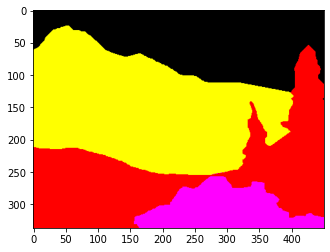

In [14]:
plt.imshow(rgb_image)
plt.show()

In [15]:
rgb_labels = []
one_hot_labels = []
for label in labels:
    one_hot_image = tf.one_hot(label, depth=len(class_colors))
    rgb_image = tf.gather(class_colors, tf.argmax(one_hot_image, axis=-1))
    rgb_image = tf.cast(rgb_image, tf.uint8)
    rgb_labels.append(rgb_image)
    one_hot_labels.append(one_hot_image)

rgb_labels = np.array(rgb_labels)
one_hot_labels = np.array(one_hot_labels)

In [16]:
one_hot_labels.shape

(250, 337, 450, 9)

In [17]:
new_images = []
for image in one_hot_labels:
    new_image = np.concatenate((image, np.zeros((337, 450, 3))), axis=2)
    new_images.append(new_image)

# The new images have shape (256, 256, 12)
new_images = np.array(new_images)

In [18]:
new_images.shape

(250, 337, 450, 12)

In [19]:
new_images[0][0][0]

array([1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [20]:
one_hot_labels = new_images

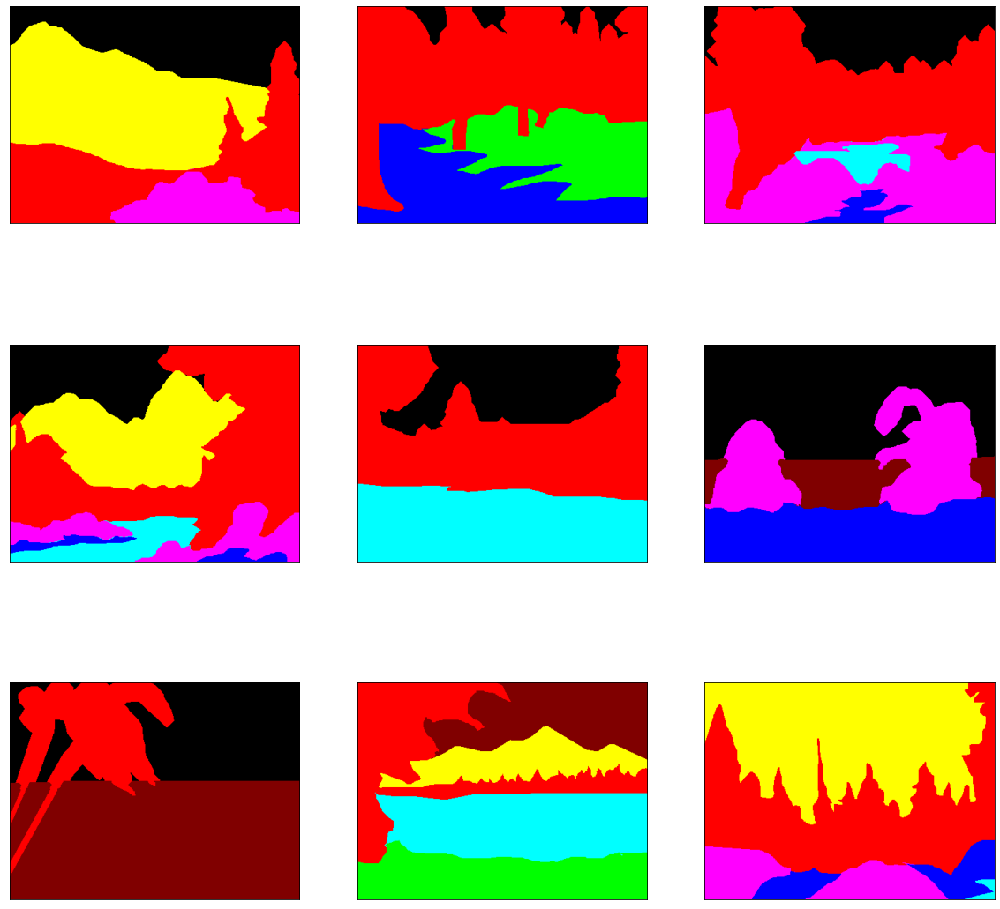

In [21]:
# plot 9 rgb labels
fig, ax = plt.subplots(3, 3, figsize=(20, 20))
for i, axi in enumerate(ax.flat):
    axi.imshow(rgb_labels[i])
    axi.set(xticks=[], yticks=[])
plt.show()


In [22]:
len(np.unique(rgb_labels))

3

In [23]:
IMG_WIDTH = 256
IMG_HEIGHT = 256
BATCH_SIZE = 16

In [24]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image, label_encoding):

  # Convert uint8 to float32
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image, label_encoding

In [25]:
print(rgb_labels.shape)
print(images.shape)
print(one_hot_labels.shape)

(250, 337, 450, 3)
(250, 337, 450, 3)
(250, 337, 450, 12)


In [26]:
def _random_crop(
        segmentation_map, image, labels, crop_size=(IMG_HEIGHT, IMG_WIDTH),
    ):
        crop_size = tf.convert_to_tensor(crop_size)
        image_shape = tf.shape(image)[:2]
        margins = image_shape - crop_size
        y1 = tf.random.uniform(shape=(), maxval=margins[0], dtype=tf.int32)
        x1 = tf.random.uniform(shape=(), maxval=margins[1], dtype=tf.int32)
        y2 = y1 + crop_size[0]
        x2 = x1 + crop_size[1]

        cropped_images = []
        images = [segmentation_map, image, labels]
        for img in images:
            cropped_images.append(img[y1:y2, x1:x2])
        return cropped_images

In [27]:
def random_crop(input_image, real_image, one_hot_encoding):
  stacked_image = tf.stack([input_image, real_image, one_hot_encoding], axis=0)
  cropped_image = tf.image.random_crop(stacked_image, size=[3, IMG_HEIGHT, IMG_WIDTH, None])

  return cropped_image[0], cropped_image[1], cropped_image[2]

In [28]:
@tf.function()
def random_jitter(input_image, real_image, one_hot_encoding):
  input_image, real_image, one_hot_encoding = _random_crop(input_image, real_image, one_hot_encoding)

  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)
    one_hot_encoding = tf.image.flip_left_right(one_hot_encoding)

  return input_image, real_image, one_hot_encoding

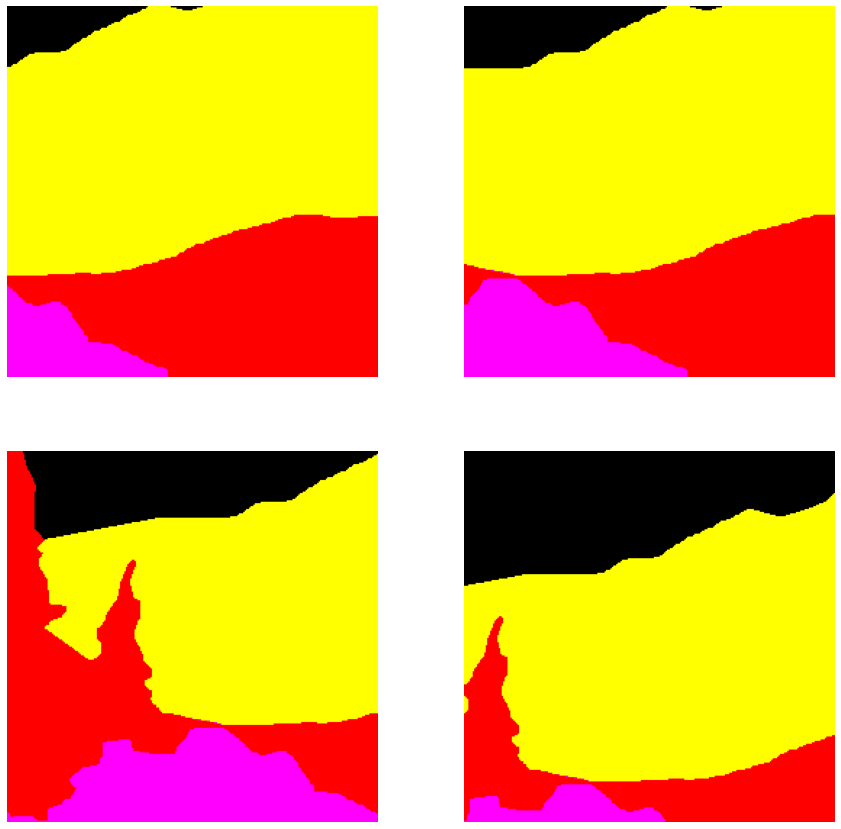

In [29]:
plt.figure(figsize=(15, 15))
for i in range(4):
  rj_inp, rj_re, rj_lab = random_jitter(rgb_labels[0], images[0], one_hot_labels[0])
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp)
  plt.axis('off')
plt.show()

In [30]:
TRAIN_SIZE = 230
TEST_SIZE = 20

BATCH_SIZE = 4
BUFFER_SIZE = 1000

In [31]:
AUTOTUNE = tf.data.AUTOTUNE

In [32]:
# Create a tf.data.Dataset
train_dataset = tf.data.Dataset.from_tensor_slices((rgb_labels[:TRAIN_SIZE], images[:TRAIN_SIZE], one_hot_labels[:TRAIN_SIZE]))
train_dataset = train_dataset.shuffle(BATCH_SIZE * 10)
train_dataset = train_dataset.map(lambda x, y, z: random_jitter(x, y, z), num_parallel_calls=AUTOTUNE)
train_dataset = train_dataset.batch(BATCH_SIZE, drop_remainder=True)

In [33]:
# Create a tf.data.Dataset
test_dataset = tf.data.Dataset.from_tensor_slices((rgb_labels[-TEST_SIZE:], images[-TEST_SIZE:], one_hot_labels[-TEST_SIZE:]))
test_dataset = test_dataset.shuffle(BATCH_SIZE * 10)
test_dataset = test_dataset.map(lambda x, y, z: random_jitter(x, y, z), num_parallel_calls=AUTOTUNE)
test_dataset = test_dataset.batch(BATCH_SIZE, drop_remainder=True)

In [34]:
# Normalize the images with map and lambda
train_dataset = train_dataset.map(lambda x, y, z: normalize(x, y, z), num_parallel_calls=AUTOTUNE)
test_dataset = test_dataset.map(lambda x, y, z: normalize(x, y, z), num_parallel_calls=AUTOTUNE)

Segmentation map batch shape: (4, 256, 256, 3).
Image batch shape: (4, 256, 256, 3).
One-hot encoded label map shape: (4, 256, 256, 12).


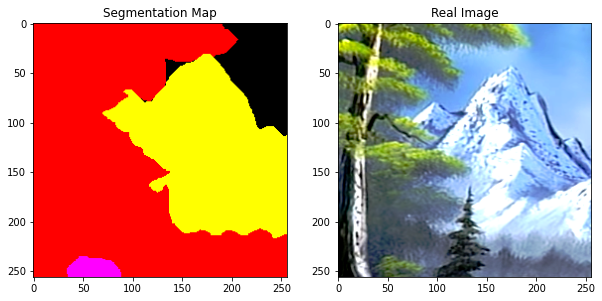

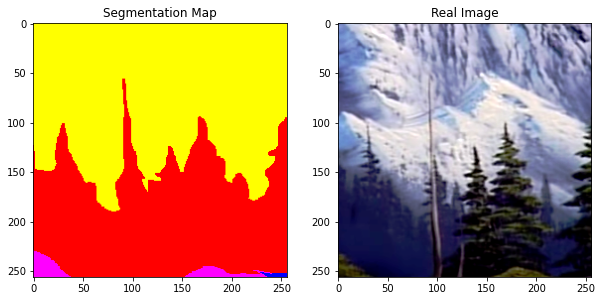

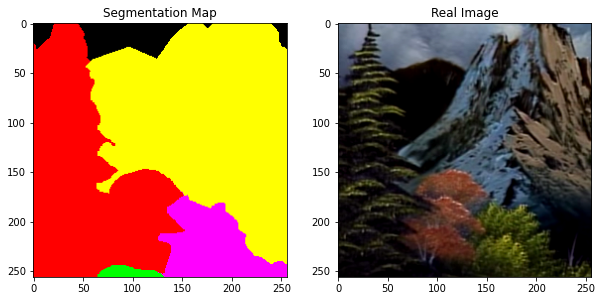

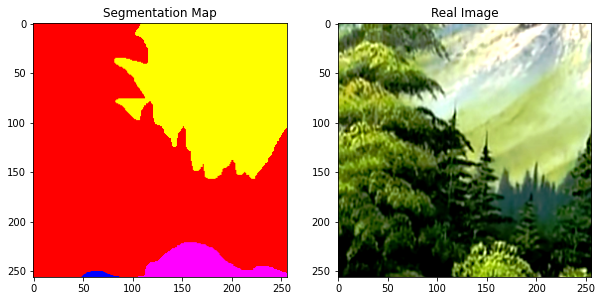

In [35]:
sample_train_batch = next(iter(train_dataset))
print(f"Segmentation map batch shape: {sample_train_batch[0].shape}.")
print(f"Image batch shape: {sample_train_batch[1].shape}.")
print(f"One-hot encoded label map shape: {sample_train_batch[2].shape}.")

# Plot a view samples from the training set.
for segmentation_map, real_image in zip(sample_train_batch[0], sample_train_batch[1]):
    fig = plt.figure(figsize=(10, 10))
    fig.add_subplot(1, 2, 1).set_title("Segmentation Map")
    plt.imshow((segmentation_map + 1) / 2)
    fig.add_subplot(1, 2, 2).set_title("Real Image")
    plt.imshow((real_image + 1) / 2)
    plt.show()

# Model

In [36]:
from tensorflow.keras import layers

In [37]:
! pip install tensorflow_addons

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 46.0 MB/s eta 0:00:00


In [38]:
import tensorflow_addons as tfa

In [39]:
from tensorflow import keras

In [40]:

class SPADE(layers.Layer):
    def __init__(self, filters, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon
        self.conv = layers.Conv2D(128, 3, padding="same", activation="relu")
        self.conv_gamma = layers.Conv2D(filters, 3, padding="same")
        self.conv_beta = layers.Conv2D(filters, 3, padding="same")

    def build(self, input_shape):
        self.resize_shape = input_shape[1:3]

    def call(self, input_tensor, raw_mask):
        mask = tf.image.resize(raw_mask, self.resize_shape, method="nearest")
        x = self.conv(mask)
        gamma = self.conv_gamma(x)
        beta = self.conv_beta(x)
        mean, var = tf.nn.moments(input_tensor, axes=(0, 1, 2), keepdims=True)
        std = tf.sqrt(var + self.epsilon)
        normalized = (input_tensor - mean) / std
        output = gamma * normalized + beta
        return output


class ResBlock(layers.Layer):
    def __init__(self, filters, **kwargs):
        super().__init__(**kwargs)
        self.filters = filters

    def build(self, input_shape):
        input_filter = input_shape[-1]
        self.spade_1 = SPADE(input_filter)
        self.spade_2 = SPADE(self.filters)
        self.conv_1 = layers.Conv2D(self.filters, 3, padding="same")
        self.conv_2 = layers.Conv2D(self.filters, 3, padding="same")
        self.learned_skip = False

        if self.filters != input_filter:
            self.learned_skip = True
            self.spade_3 = SPADE(input_filter)
            self.conv_3 = layers.Conv2D(self.filters, 3, padding="same")

    def call(self, input_tensor, mask):
        x = self.spade_1(input_tensor, mask)
        x = self.conv_1(tf.nn.leaky_relu(x, 0.2))
        x = self.spade_2(x, mask)
        x = self.conv_2(tf.nn.leaky_relu(x, 0.2))
        skip = (
            self.conv_3(tf.nn.leaky_relu(self.spade_3(input_tensor, mask), 0.2))
            if self.learned_skip
            else input_tensor
        )
        output = skip + x
        return output


class GaussianSampler(layers.Layer):
    def __init__(self, batch_size, latent_dim, **kwargs):
        super().__init__(**kwargs)
        self.batch_size = batch_size
        self.latent_dim = latent_dim

    def call(self, inputs):
        means, variance = inputs
        epsilon = tf.random.normal(
            shape=(self.batch_size, self.latent_dim), mean=0.0, stddev=1.0
        )
        samples = means + tf.exp(0.5 * variance) * epsilon
        return samples


In [41]:

def downsample(
    channels,
    kernels,
    strides=2,
    apply_norm=True,
    apply_activation=True,
    apply_dropout=False,
):
    block = keras.Sequential()
    block.add(
        layers.Conv2D(
            channels,
            kernels,
            strides=strides,
            padding="same",
            use_bias=False,
            kernel_initializer=keras.initializers.GlorotNormal(),
        )
    )
    if apply_norm:
        block.add(tfa.layers.InstanceNormalization())
    if apply_activation:
        block.add(layers.LeakyReLU(0.2))
    if apply_dropout:
        block.add(layers.Dropout(0.5))
    return block


In [42]:

def build_encoder(image_shape, encoder_downsample_factor=64, latent_dim=256):
    input_image = keras.Input(shape=image_shape)
    x = downsample(encoder_downsample_factor, 3, apply_norm=False)(input_image)
    x = downsample(2 * encoder_downsample_factor, 3)(x)
    x = downsample(4 * encoder_downsample_factor, 3)(x)
    x = downsample(8 * encoder_downsample_factor, 3)(x)
    x = downsample(8 * encoder_downsample_factor, 3)(x)
    x = layers.Flatten()(x)
    mean = layers.Dense(latent_dim, name="mean")(x)
    variance = layers.Dense(latent_dim, name="variance")(x)
    return keras.Model(input_image, [mean, variance], name="encoder")


In [43]:

def build_generator(mask_shape, latent_dim=256):
    latent = keras.Input(shape=(latent_dim))
    mask = keras.Input(shape=mask_shape)
    x = layers.Dense(16384)(latent)
    x = layers.Reshape((4, 4, 1024))(x)
    x = ResBlock(filters=1024)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = ResBlock(filters=1024)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = ResBlock(filters=1024)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = ResBlock(filters=512)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = ResBlock(filters=256)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = ResBlock(filters=128)(x, mask)
    x = layers.UpSampling2D((2, 2))(x)
    x = tf.nn.leaky_relu(x, 0.2)
    output_image = tf.nn.tanh(layers.Conv2D(3, 4, padding="same")(x))
    return keras.Model([latent, mask], output_image, name="generator")


In [44]:

def build_discriminator(image_shape, downsample_factor=64):
    input_image_A = keras.Input(shape=image_shape, name="discriminator_image_A")
    input_image_B = keras.Input(shape=image_shape, name="discriminator_image_B")
    x = layers.Concatenate()([input_image_A, input_image_B])
    x1 = downsample(downsample_factor, 4, apply_norm=False)(x)
    x2 = downsample(2 * downsample_factor, 4)(x1)
    x3 = downsample(4 * downsample_factor, 4)(x2)
    x4 = downsample(8 * downsample_factor, 4, strides=1)(x3)
    x5 = layers.Conv2D(1, 4)(x4)
    outputs = [x1, x2, x3, x4, x5]
    return keras.Model([input_image_A, input_image_B], outputs)


In [45]:

def generator_loss(y):
    return -tf.reduce_mean(y)


def kl_divergence_loss(mean, variance):
    return -0.5 * tf.reduce_sum(1 + variance - tf.square(mean) - tf.exp(variance))


class FeatureMatchingLoss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.mae = keras.losses.MeanAbsoluteError()

    def call(self, y_true, y_pred):
        loss = 0
        for i in range(len(y_true) - 1):
            loss += self.mae(y_true[i], y_pred[i])
        return loss


class VGGFeatureMatchingLoss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.encoder_layers = [
            "block1_conv1",
            "block2_conv1",
            "block3_conv1",
            "block4_conv1",
            "block5_conv1",
        ]
        self.weights = [1.0 / 32, 1.0 / 16, 1.0 / 8, 1.0 / 4, 1.0]
        vgg = keras.applications.VGG19(include_top=False, weights="imagenet")
        layer_outputs = [vgg.get_layer(x).output for x in self.encoder_layers]
        self.vgg_model = keras.Model(vgg.input, layer_outputs, name="VGG")
        self.mae = keras.losses.MeanAbsoluteError()

    def call(self, y_true, y_pred):
        y_true = keras.applications.vgg19.preprocess_input(127.5 * (y_true + 1))
        y_pred = keras.applications.vgg19.preprocess_input(127.5 * (y_pred + 1))
        real_features = self.vgg_model(y_true)
        fake_features = self.vgg_model(y_pred)
        loss = 0
        for i in range(len(real_features)):
            loss += self.weights[i] * self.mae(real_features[i], fake_features[i])
        return loss


class DiscriminatorLoss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.hinge_loss = keras.losses.Hinge()

    def call(self, y, is_real):
        label = 1.0 if is_real else -1.0
        return self.hinge_loss(label, y)


In [56]:
def generate_images(model, test_input, tar):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # Getting the pixel values in the [0, 1] range to plot.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

In [59]:

class GanMonitor(keras.callbacks.Callback):
    def __init__(self, val_dataset, n_samples, epoch_interval=5):
        self.val_images = next(iter(val_dataset))
        self.n_samples = n_samples
        self.epoch_interval = epoch_interval

    def infer(self):
        latent_vector = tf.random.normal(
            shape=(self.model.batch_size, self.model.latent_dim), mean=0.0, stddev=2.0
        )
        return self.model.predict([latent_vector, self.val_images[2]])

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.epoch_interval == 0:
            generated_images = self.infer()
            # for _ in range(self.n_samples):
            grid_row = min(generated_images.shape[0], 3)
            f, axarr = plt.subplots(grid_row, 3, figsize=(18, grid_row * 6))
            for row in range(grid_row):
                ax = axarr if grid_row == 1 else axarr[row]
                ax[0].imshow((self.val_images[0][row] + 1) / 2)
                ax[0].axis("off")
                ax[0].set_title("Mask", fontsize=20)
                ax[1].imshow((self.val_images[1][row] + 1) / 2)
                ax[1].axis("off")
                ax[1].set_title("Ground Truth", fontsize=20)
                ax[2].imshow((generated_images[row] + 1) / 2)
                ax[2].axis("off")
                ax[2].set_title("Generated", fontsize=20)
            plt.show()


In [62]:
class GanCheckpoint(keras.callbacks.Callback):
    def __init__(self, epoch_interval=10):
        self.epoch_interval = epoch_interval
        self.checkpoint_dir = './spade_checkpoints'
        self.checkpoint_prefix = os.path.join(self.checkpoint_dir, "ckpt")
    
    def on_train_begin(self, logs=None):
        self.checkpoint = tf.train.Checkpoint(generator_optimizer=self.model.generator_optimizer,
                                             discriminator_optimizer=self.model.discriminator_optimizer,
                                             generator=self.model.generator,
                                             discriminator=self.model.discriminator)
        
        self.checkpoint.restore(tf.train.latest_checkpoint(self.checkpoint_dir))
    
    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.epoch_interval == 0 and epoch != 0:
            self.checkpoint.save(file_prefix=self.checkpoint_prefix)


In [48]:

class GauGAN(keras.Model):
    def __init__(
        self,
        image_size,
        num_classes,
        batch_size,
        latent_dim,
        feature_loss_coeff=10,
        vgg_feature_loss_coeff=0.1,
        kl_divergence_loss_coeff=0.1,
        **kwargs,
    ):
        super().__init__(**kwargs)

        self.image_size = image_size
        self.latent_dim = latent_dim
        self.batch_size = batch_size
        self.num_classes = num_classes
        self.image_shape = (image_size, image_size, 3)
        self.mask_shape = (image_size, image_size, num_classes)
        self.feature_loss_coeff = feature_loss_coeff
        self.vgg_feature_loss_coeff = vgg_feature_loss_coeff
        self.kl_divergence_loss_coeff = kl_divergence_loss_coeff

        self.discriminator = build_discriminator(self.image_shape)
        self.generator = build_generator(self.mask_shape)
        self.encoder = build_encoder(self.image_shape)
        self.sampler = GaussianSampler(batch_size, latent_dim)
        self.patch_size, self.combined_model = self.build_combined_generator()

        self.disc_loss_tracker = tf.keras.metrics.Mean(name="disc_loss")
        self.gen_loss_tracker = tf.keras.metrics.Mean(name="gen_loss")
        self.feat_loss_tracker = tf.keras.metrics.Mean(name="feat_loss")
        self.vgg_loss_tracker = tf.keras.metrics.Mean(name="vgg_loss")
        self.kl_loss_tracker = tf.keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.disc_loss_tracker,
            self.gen_loss_tracker,
            self.feat_loss_tracker,
            self.vgg_loss_tracker,
            self.kl_loss_tracker,
        ]

    def build_combined_generator(self):
        # This method builds a model that takes as inputs the following:
        # latent vector, one-hot encoded segmentation label map, and
        # a segmentation map. It then (i) generates an image with the generator,
        # (ii) passes the generated images and segmentation map to the discriminator.
        # Finally, the model produces the following outputs: (a) discriminator outputs,
        # (b) generated image.
        # We will be using this model to simplify the implementation.
        self.discriminator.trainable = False
        mask_input = keras.Input(shape=self.mask_shape, name="mask")
        image_input = keras.Input(shape=self.image_shape, name="image")
        latent_input = keras.Input(shape=(self.latent_dim), name="latent")
        generated_image = self.generator([latent_input, mask_input])
        discriminator_output = self.discriminator([image_input, generated_image])
        patch_size = discriminator_output[-1].shape[1]
        combined_model = keras.Model(
            [latent_input, mask_input, image_input],
            [discriminator_output, generated_image],
        )
        return patch_size, combined_model

    def compile(self, gen_lr=1e-4, disc_lr=4e-4, **kwargs):
        super().compile(**kwargs)
        self.generator_optimizer = keras.optimizers.Adam(
            gen_lr, beta_1=0.0, beta_2=0.999
        )
        self.discriminator_optimizer = keras.optimizers.Adam(
            disc_lr, beta_1=0.0, beta_2=0.999
        )
        self.discriminator_loss = DiscriminatorLoss()
        self.feature_matching_loss = FeatureMatchingLoss()
        self.vgg_loss = VGGFeatureMatchingLoss()

    def train_discriminator(self, latent_vector, segmentation_map, real_image, labels):
        fake_images = self.generator([latent_vector, labels])
        with tf.GradientTape() as gradient_tape:
            pred_fake = self.discriminator([segmentation_map, fake_images])[-1]
            pred_real = self.discriminator([segmentation_map, real_image])[-1]
            loss_fake = self.discriminator_loss(pred_fake, False)
            loss_real = self.discriminator_loss(pred_real, True)
            total_loss = 0.5 * (loss_fake + loss_real)

        self.discriminator.trainable = True
        # Incompatible shapes: [2,64,64,128] vs. [4,1,1,128]
        print(f'{total_loss=}')
        print(f'{self.discriminator.trainable_variables=}')
        gradients = gradient_tape.gradient(
            total_loss, self.discriminator.trainable_variables
        )
        self.discriminator_optimizer.apply_gradients(
            zip(gradients, self.discriminator.trainable_variables)
        )
        return total_loss

    def train_generator(
        self, latent_vector, segmentation_map, labels, image, mean, variance
    ):
        # Generator learns through the signal provided by the discriminator. During
        # backpropagation, we only update the generator parameters.
        self.discriminator.trainable = False
        with tf.GradientTape() as tape:
            real_d_output = self.discriminator([segmentation_map, image])
            fake_d_output, fake_image = self.combined_model(
                [latent_vector, labels, segmentation_map]
            )
            pred = fake_d_output[-1]

            # Compute generator losses.
            g_loss = generator_loss(pred)
            kl_loss = self.kl_divergence_loss_coeff * kl_divergence_loss(mean, variance)
            vgg_loss = self.vgg_feature_loss_coeff * self.vgg_loss(image, fake_image)
            feature_loss = self.feature_loss_coeff * self.feature_matching_loss(
                real_d_output, fake_d_output
            )
            total_loss = g_loss + kl_loss + vgg_loss + feature_loss

        all_trainable_variables = (
            self.combined_model.trainable_variables + self.encoder.trainable_variables
        )

        gradients = tape.gradient(total_loss, all_trainable_variables)
        self.generator_optimizer.apply_gradients(
            zip(gradients, all_trainable_variables)
        )
        return total_loss, feature_loss, vgg_loss, kl_loss

    def train_step(self, data):
        segmentation_map, image, labels = data
        mean, variance = self.encoder(image)
        latent_vector = self.sampler([mean, variance])

        # ERROR - Incompatible shapes: [2,64,64,128] vs. [4,1,1,128]

        discriminator_loss = self.train_discriminator(
            latent_vector, segmentation_map, image, labels
        )
        (generator_loss, feature_loss, vgg_loss, kl_loss) = self.train_generator(
            latent_vector, segmentation_map, labels, image, mean, variance
        )

        # Report progress.
        self.disc_loss_tracker.update_state(discriminator_loss)
        self.gen_loss_tracker.update_state(generator_loss)
        self.feat_loss_tracker.update_state(feature_loss)
        self.vgg_loss_tracker.update_state(vgg_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        results = {m.name: m.result() for m in self.metrics}
        return results

    def test_step(self, data):
        segmentation_map, image, labels = data
        # Obtain the learned moments of the real image distribution.
        mean, variance = self.encoder(image)

        # Sample a latent from the distribution defined by the learned moments.
        latent_vector = self.sampler([mean, variance])

        # Generate the fake images.
        fake_images = self.generator([latent_vector, labels])

        # Calculate the losses.
        pred_fake = self.discriminator([segmentation_map, fake_images])[-1]
        pred_real = self.discriminator([segmentation_map, image])[-1]
        loss_fake = self.discriminator_loss(pred_fake, False)
        loss_real = self.discriminator_loss(pred_real, True)
        total_discriminator_loss = 0.5 * (loss_fake + loss_real)
        real_d_output = self.discriminator([segmentation_map, image])
        fake_d_output, fake_image = self.combined_model(
            [latent_vector, labels, segmentation_map]
        )
        pred = fake_d_output[-1]
        g_loss = generator_loss(pred)
        kl_loss = self.kl_divergence_loss_coeff * kl_divergence_loss(mean, variance)
        vgg_loss = self.vgg_feature_loss_coeff * self.vgg_loss(image, fake_image)
        feature_loss = self.feature_loss_coeff * self.feature_matching_loss(
            real_d_output, fake_d_output
        )
        total_generator_loss = g_loss + kl_loss + vgg_loss + feature_loss

        # Report progress.
        self.disc_loss_tracker.update_state(total_discriminator_loss)
        self.gen_loss_tracker.update_state(total_generator_loss)
        self.feat_loss_tracker.update_state(feature_loss)
        self.vgg_loss_tracker.update_state(vgg_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        results = {m.name: m.result() for m in self.metrics}
        return results

    def call(self, inputs):
        latent_vectors, labels = inputs
        return self.generator([latent_vectors, labels])


In [49]:
NUM_CLASSES = 12

In [63]:
gaugan = GauGAN(IMG_HEIGHT, NUM_CLASSES, BATCH_SIZE, latent_dim=256)
gaugan.compile()

Epoch 1/110
1/1 [==============================] - 0s 38ms/step


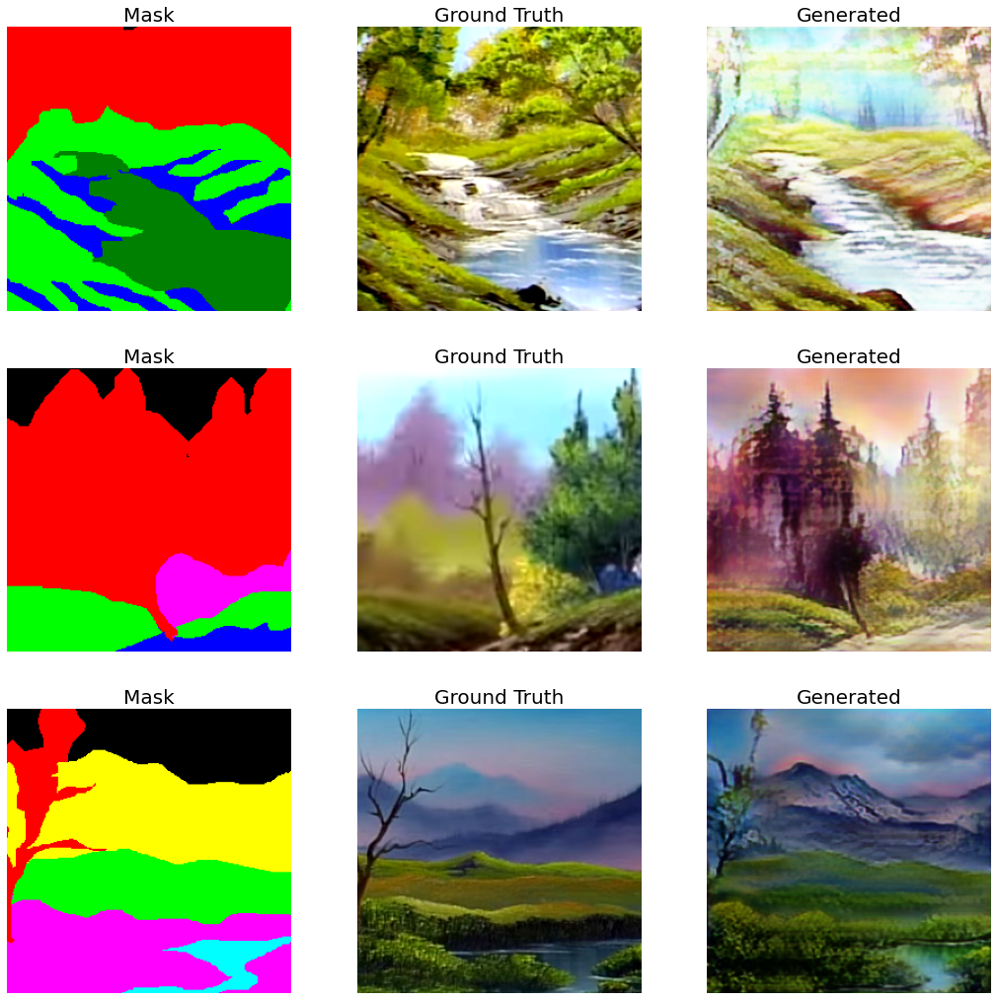

57/57 [==============================] - 24s 413ms/step - disc_loss: 0.5876 - gen_loss: 111.8161 - feat_loss: 8.1962 - vgg_loss: 15.1244 - kl_loss: 87.5810 - val_disc_loss: 0.9311 - val_gen_loss: 118.9646 - val_feat_loss: 10.8636 - val_vgg_loss: 18.9712 - val_kl_loss: 87.5985
Epoch 2/110
57/57 [==============================] - 22s 385ms/step - disc_loss: 0.6377 - gen_loss: 111.1934 - feat_loss: 8.1587 - vgg_loss: 15.1080 - kl_loss: 87.1004 - val_disc_loss: 0.7408 - val_gen_loss: 118.2394 - val_feat_loss: 10.5929 - val_vgg_loss: 18.3613 - val_kl_loss: 88.1296
Epoch 3/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6091 - gen_loss: 111.5719 - feat_loss: 8.2361 - vgg_loss: 15.1102 - kl_loss: 87.3042 - val_disc_loss: 0.6218 - val_gen_loss: 119.5148 - val_feat_loss: 10.7361 - val_vgg_loss: 18.6509 - val_kl_loss: 88.8726
Epoch 4/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6083 - gen_loss: 112.0429 - feat_loss: 8.2369 - vgg_loss: 15.0

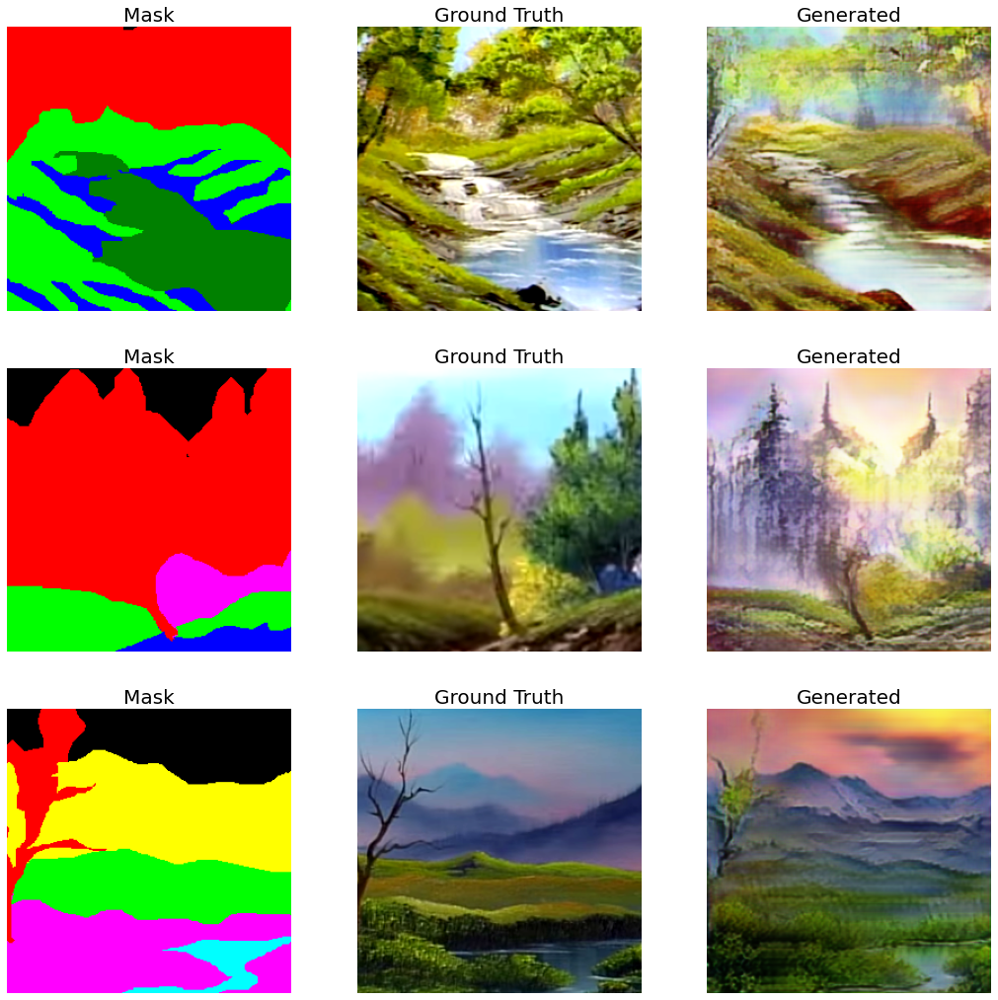

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6118 - gen_loss: 112.1337 - feat_loss: 8.3065 - vgg_loss: 15.2453 - kl_loss: 87.7081 - val_disc_loss: 0.7573 - val_gen_loss: 118.5758 - val_feat_loss: 11.5209 - val_vgg_loss: 19.0403 - val_kl_loss: 87.6320
Epoch 7/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6184 - gen_loss: 112.7470 - feat_loss: 8.2681 - vgg_loss: 15.1474 - kl_loss: 88.4499 - val_disc_loss: 0.6031 - val_gen_loss: 117.0906 - val_feat_loss: 10.9812 - val_vgg_loss: 18.5059 - val_kl_loss: 86.7982
Epoch 8/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6128 - gen_loss: 111.2548 - feat_loss: 8.2303 - vgg_loss: 15.1466 - kl_loss: 86.9554 - val_disc_loss: 0.8607 - val_gen_loss: 117.3698 - val_feat_loss: 11.1974 - val_vgg_loss: 18.6607 - val_kl_loss: 87.0698
Epoch 9/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6185 - gen_loss: 110.9994 - feat_loss: 8.0959 - vgg_loss: 14.9

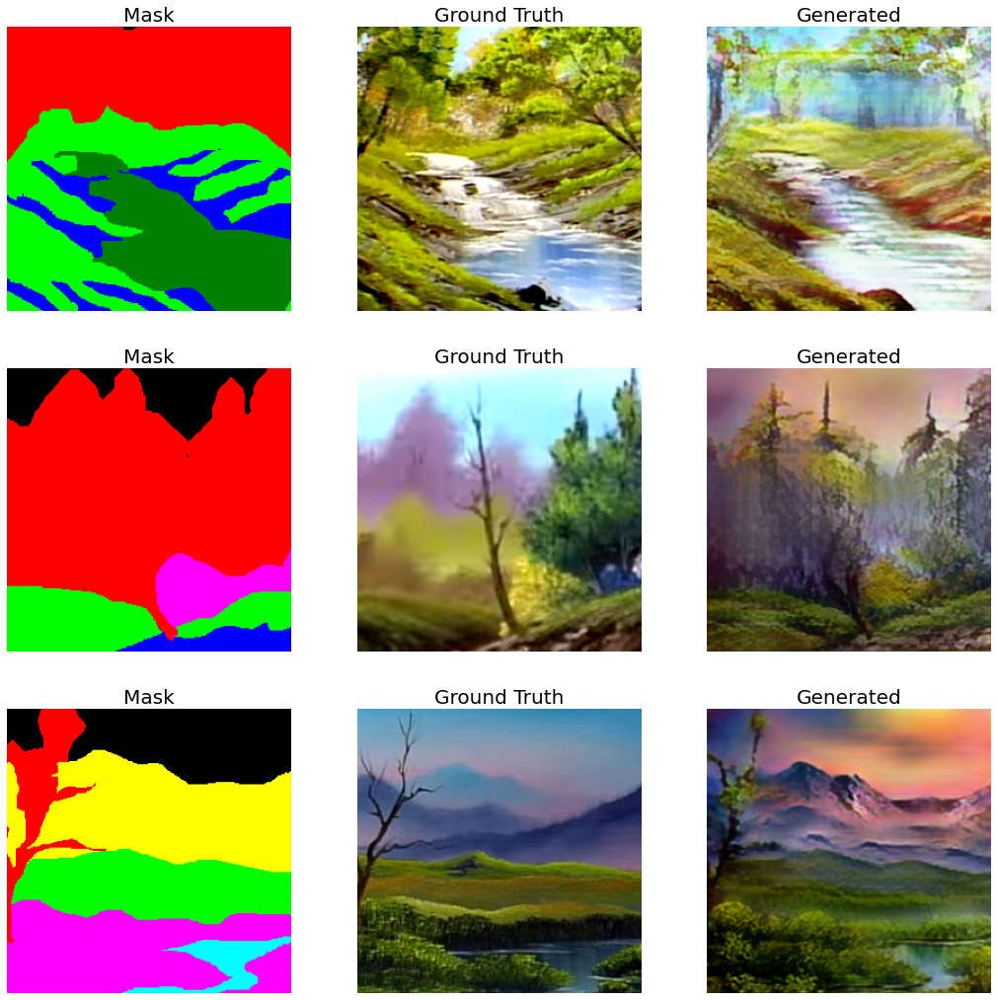

57/57 [==============================] - 23s 401ms/step - disc_loss: 0.5950 - gen_loss: 110.8035 - feat_loss: 8.2227 - vgg_loss: 15.1714 - kl_loss: 86.5254 - val_disc_loss: 0.8340 - val_gen_loss: 118.7732 - val_feat_loss: 11.1088 - val_vgg_loss: 19.0708 - val_kl_loss: 88.0717
Epoch 12/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6170 - gen_loss: 111.2345 - feat_loss: 8.1879 - vgg_loss: 15.1991 - kl_loss: 86.9467 - val_disc_loss: 0.6732 - val_gen_loss: 118.2688 - val_feat_loss: 10.8669 - val_vgg_loss: 18.7958 - val_kl_loss: 88.2049
Epoch 13/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6024 - gen_loss: 111.1938 - feat_loss: 8.1250 - vgg_loss: 15.0662 - kl_loss: 87.0791 - val_disc_loss: 0.7986 - val_gen_loss: 118.0000 - val_feat_loss: 11.1203 - val_vgg_loss: 18.8237 - val_kl_loss: 87.5303
Epoch 14/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6426 - gen_loss: 110.9108 - feat_loss: 8.2127 - vgg_loss: 1

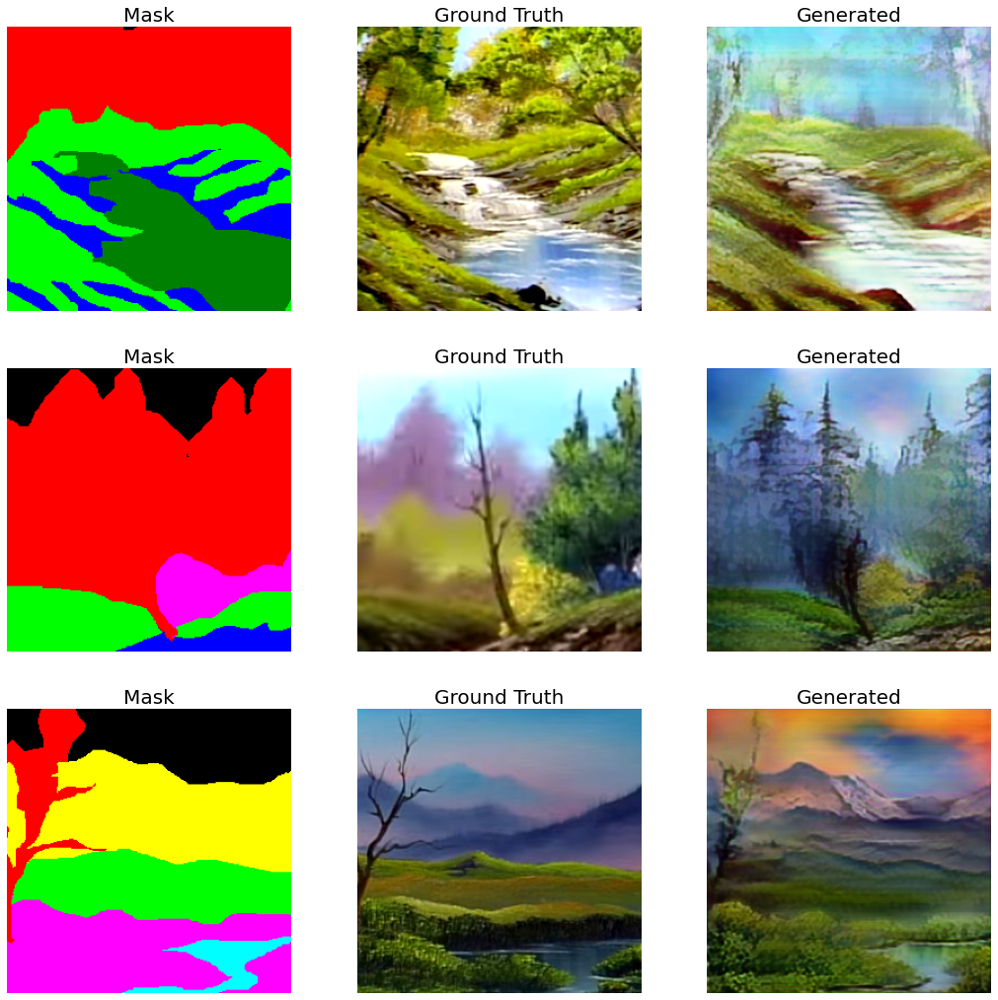

57/57 [==============================] - 23s 406ms/step - disc_loss: 0.6450 - gen_loss: 111.5654 - feat_loss: 8.0909 - vgg_loss: 15.0292 - kl_loss: 87.6258 - val_disc_loss: 0.8793 - val_gen_loss: 116.6721 - val_feat_loss: 10.6396 - val_vgg_loss: 18.3518 - val_kl_loss: 85.7160
Epoch 17/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6139 - gen_loss: 111.0196 - feat_loss: 8.1048 - vgg_loss: 15.0793 - kl_loss: 86.9363 - val_disc_loss: 0.7126 - val_gen_loss: 119.2646 - val_feat_loss: 11.0947 - val_vgg_loss: 18.6269 - val_kl_loss: 88.2673
Epoch 18/110
57/57 [==============================] - 22s 381ms/step - disc_loss: 0.6429 - gen_loss: 111.5770 - feat_loss: 8.1562 - vgg_loss: 15.0795 - kl_loss: 87.5062 - val_disc_loss: 0.7468 - val_gen_loss: 119.7157 - val_feat_loss: 11.3792 - val_vgg_loss: 18.7921 - val_kl_loss: 89.1458
Epoch 19/110
57/57 [==============================] - 22s 385ms/step - disc_loss: 0.5975 - gen_loss: 110.3384 - feat_loss: 8.0384 - vgg_loss: 1

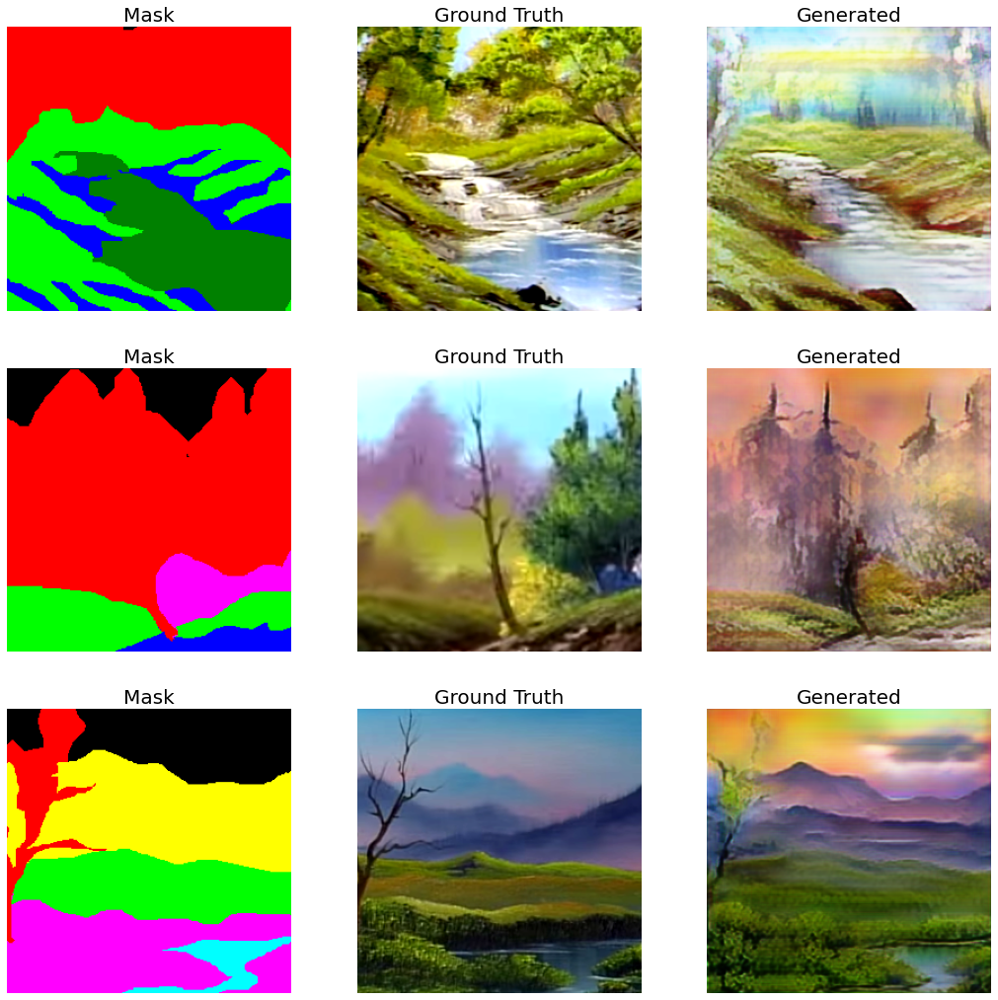

57/57 [==============================] - 23s 398ms/step - disc_loss: 0.6344 - gen_loss: 110.7995 - feat_loss: 8.1008 - vgg_loss: 15.0065 - kl_loss: 86.8708 - val_disc_loss: 0.6478 - val_gen_loss: 119.8858 - val_feat_loss: 11.1224 - val_vgg_loss: 18.9767 - val_kl_loss: 89.2657
Epoch 22/110
57/57 [==============================] - 22s 382ms/step - disc_loss: 0.6304 - gen_loss: 110.3017 - feat_loss: 8.0013 - vgg_loss: 14.9136 - kl_loss: 86.5548 - val_disc_loss: 0.6890 - val_gen_loss: 116.9387 - val_feat_loss: 10.9643 - val_vgg_loss: 18.8256 - val_kl_loss: 86.3064
Epoch 23/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6299 - gen_loss: 110.4493 - feat_loss: 8.0489 - vgg_loss: 15.0298 - kl_loss: 86.4791 - val_disc_loss: 0.7952 - val_gen_loss: 118.5093 - val_feat_loss: 11.1269 - val_vgg_loss: 19.0162 - val_kl_loss: 87.2595
Epoch 24/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6441 - gen_loss: 111.1318 - feat_loss: 8.1349 - vgg_loss: 1

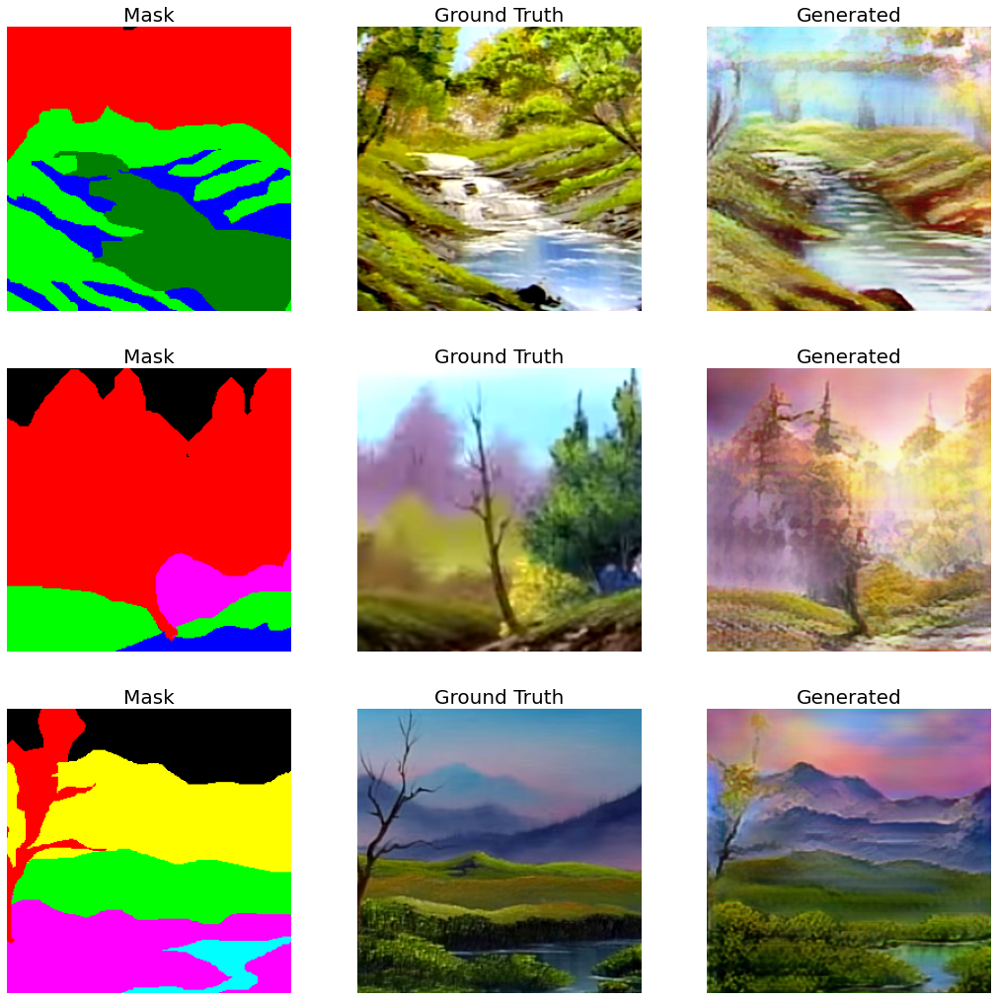

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6493 - gen_loss: 110.5414 - feat_loss: 8.1579 - vgg_loss: 14.9632 - kl_loss: 86.6269 - val_disc_loss: 0.6585 - val_gen_loss: 118.6371 - val_feat_loss: 10.9743 - val_vgg_loss: 18.6796 - val_kl_loss: 88.2794
Epoch 27/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6411 - gen_loss: 111.0156 - feat_loss: 8.0158 - vgg_loss: 14.7762 - kl_loss: 87.3741 - val_disc_loss: 0.7181 - val_gen_loss: 117.3172 - val_feat_loss: 11.1596 - val_vgg_loss: 18.9405 - val_kl_loss: 86.9772
Epoch 28/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6266 - gen_loss: 111.1316 - feat_loss: 8.1587 - vgg_loss: 15.0553 - kl_loss: 87.0647 - val_disc_loss: 0.7263 - val_gen_loss: 118.5989 - val_feat_loss: 10.9693 - val_vgg_loss: 18.8846 - val_kl_loss: 87.5848
Epoch 29/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6120 - gen_loss: 111.1882 - feat_loss: 8.0508 - vgg_loss: 1

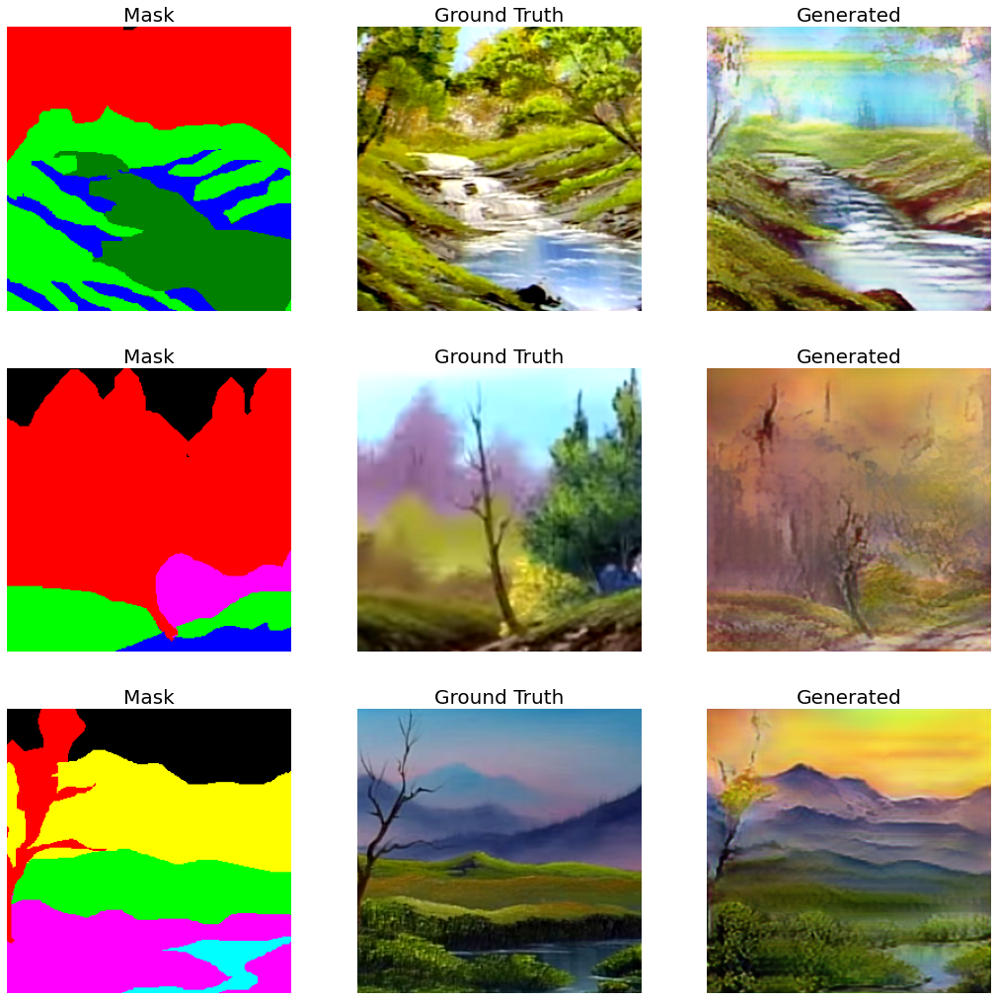

57/57 [==============================] - 23s 398ms/step - disc_loss: 0.6271 - gen_loss: 110.6199 - feat_loss: 7.9361 - vgg_loss: 14.7843 - kl_loss: 86.9711 - val_disc_loss: 0.7415 - val_gen_loss: 118.6902 - val_feat_loss: 10.9795 - val_vgg_loss: 18.9224 - val_kl_loss: 87.5018
Epoch 32/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6372 - gen_loss: 110.9896 - feat_loss: 8.0701 - vgg_loss: 14.8710 - kl_loss: 87.1884 - val_disc_loss: 0.9106 - val_gen_loss: 120.8598 - val_feat_loss: 10.9478 - val_vgg_loss: 19.1234 - val_kl_loss: 89.1844
Epoch 33/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6276 - gen_loss: 110.5436 - feat_loss: 8.0107 - vgg_loss: 14.8003 - kl_loss: 86.8985 - val_disc_loss: 0.7258 - val_gen_loss: 119.9563 - val_feat_loss: 10.9934 - val_vgg_loss: 19.0550 - val_kl_loss: 89.4670
Epoch 34/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6529 - gen_loss: 111.2221 - feat_loss: 8.0386 - vgg_loss: 1

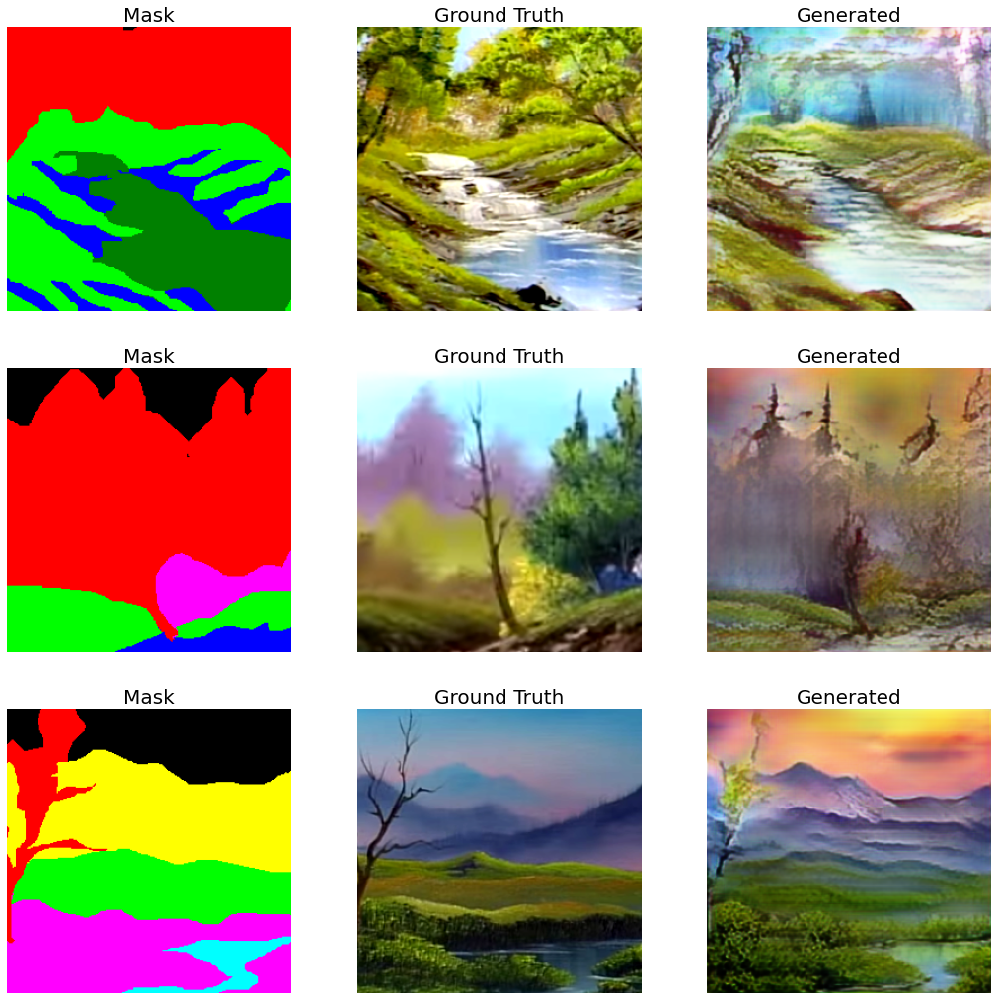

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6285 - gen_loss: 111.5662 - feat_loss: 8.0098 - vgg_loss: 14.8452 - kl_loss: 87.8667 - val_disc_loss: 0.8129 - val_gen_loss: 118.3442 - val_feat_loss: 11.2561 - val_vgg_loss: 18.9244 - val_kl_loss: 87.9350
Epoch 37/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6540 - gen_loss: 110.6991 - feat_loss: 8.0154 - vgg_loss: 14.9200 - kl_loss: 86.9415 - val_disc_loss: 0.7601 - val_gen_loss: 117.8644 - val_feat_loss: 11.2302 - val_vgg_loss: 18.9713 - val_kl_loss: 87.3610
Epoch 38/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6425 - gen_loss: 111.0639 - feat_loss: 7.9546 - vgg_loss: 14.8098 - kl_loss: 87.5017 - val_disc_loss: 0.8514 - val_gen_loss: 119.5519 - val_feat_loss: 11.0391 - val_vgg_loss: 18.5530 - val_kl_loss: 89.4585
Epoch 39/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6517 - gen_loss: 110.0251 - feat_loss: 7.9233 - vgg_loss: 1

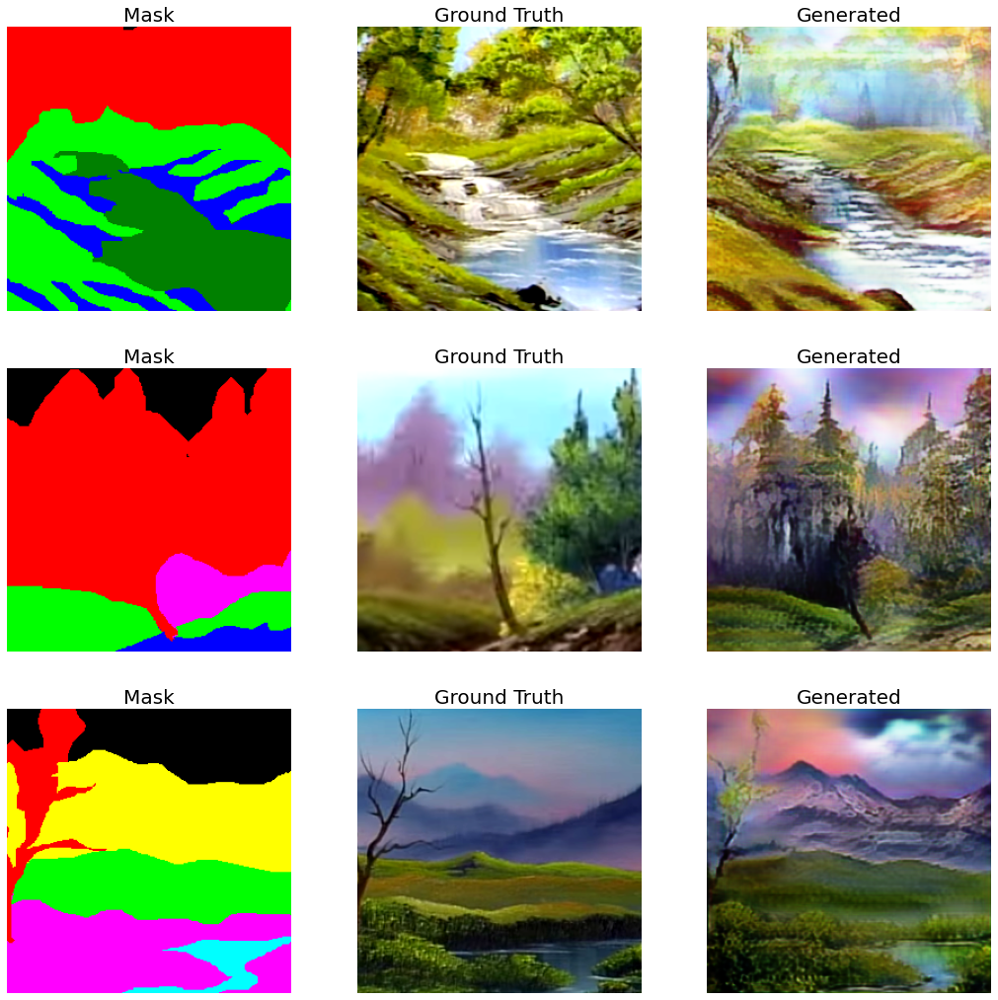

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6548 - gen_loss: 110.4716 - feat_loss: 7.9611 - vgg_loss: 14.7930 - kl_loss: 86.8329 - val_disc_loss: 0.9246 - val_gen_loss: 120.1169 - val_feat_loss: 11.0652 - val_vgg_loss: 19.1969 - val_kl_loss: 88.1528
Epoch 42/110
57/57 [==============================] - 22s 393ms/step - disc_loss: 0.6548 - gen_loss: 110.7388 - feat_loss: 7.9126 - vgg_loss: 14.7971 - kl_loss: 87.2430 - val_disc_loss: 0.8550 - val_gen_loss: 116.0106 - val_feat_loss: 11.2947 - val_vgg_loss: 19.3084 - val_kl_loss: 85.4297
Epoch 43/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6412 - gen_loss: 111.6793 - feat_loss: 7.9278 - vgg_loss: 14.7910 - kl_loss: 88.0814 - val_disc_loss: 0.8766 - val_gen_loss: 119.5995 - val_feat_loss: 10.9600 - val_vgg_loss: 18.7858 - val_kl_loss: 88.3491
Epoch 44/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6334 - gen_loss: 110.9522 - feat_loss: 7.9320 - vgg_loss: 1

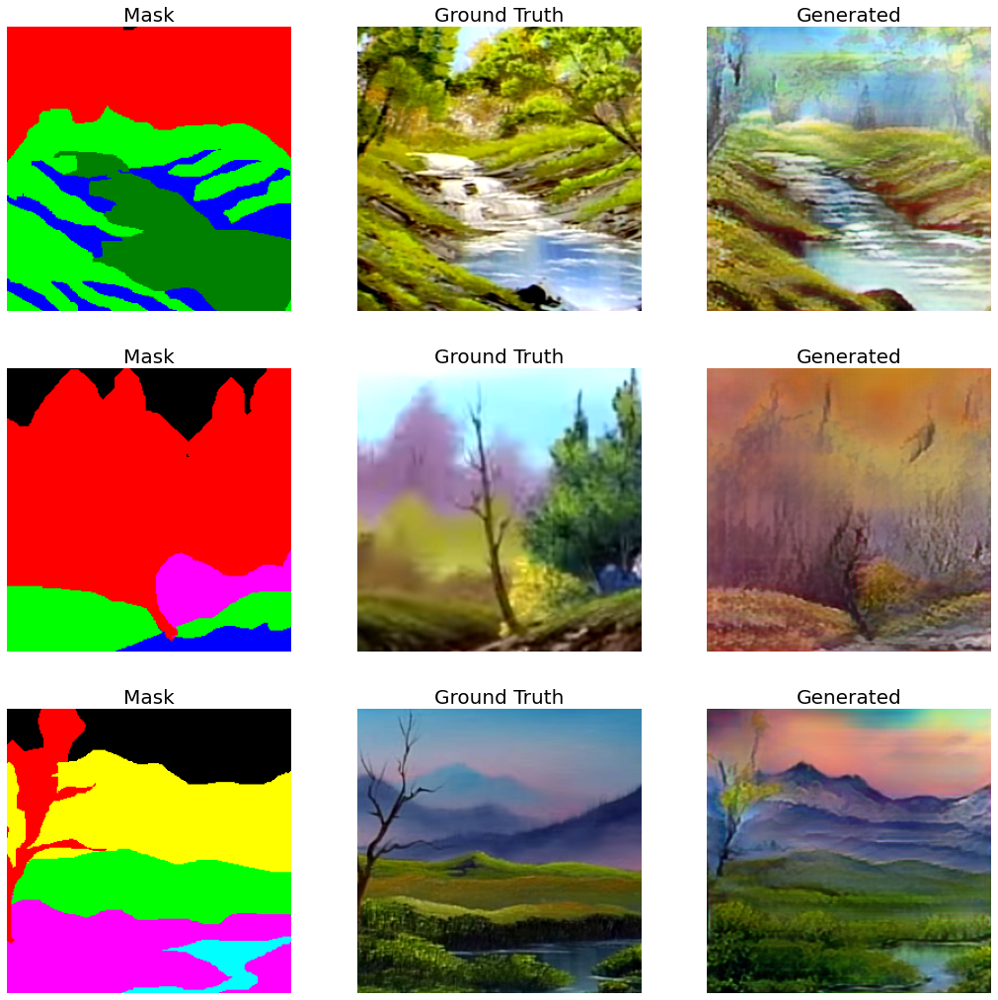

57/57 [==============================] - 23s 403ms/step - disc_loss: 0.6577 - gen_loss: 110.2391 - feat_loss: 7.9085 - vgg_loss: 14.6807 - kl_loss: 86.8635 - val_disc_loss: 1.0676 - val_gen_loss: 118.6909 - val_feat_loss: 10.7367 - val_vgg_loss: 18.3906 - val_kl_loss: 87.3564
Epoch 47/110
57/57 [==============================] - 22s 385ms/step - disc_loss: 0.6383 - gen_loss: 111.6221 - feat_loss: 7.9050 - vgg_loss: 14.6989 - kl_loss: 88.1555 - val_disc_loss: 0.6832 - val_gen_loss: 116.4387 - val_feat_loss: 10.9964 - val_vgg_loss: 18.8460 - val_kl_loss: 86.1639
Epoch 48/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6340 - gen_loss: 110.4143 - feat_loss: 7.9383 - vgg_loss: 14.7190 - kl_loss: 86.9493 - val_disc_loss: 0.7110 - val_gen_loss: 118.6017 - val_feat_loss: 11.0148 - val_vgg_loss: 18.9294 - val_kl_loss: 88.0205
Epoch 49/110
57/57 [==============================] - 22s 393ms/step - disc_loss: 0.6483 - gen_loss: 111.2087 - feat_loss: 7.8874 - vgg_loss: 1

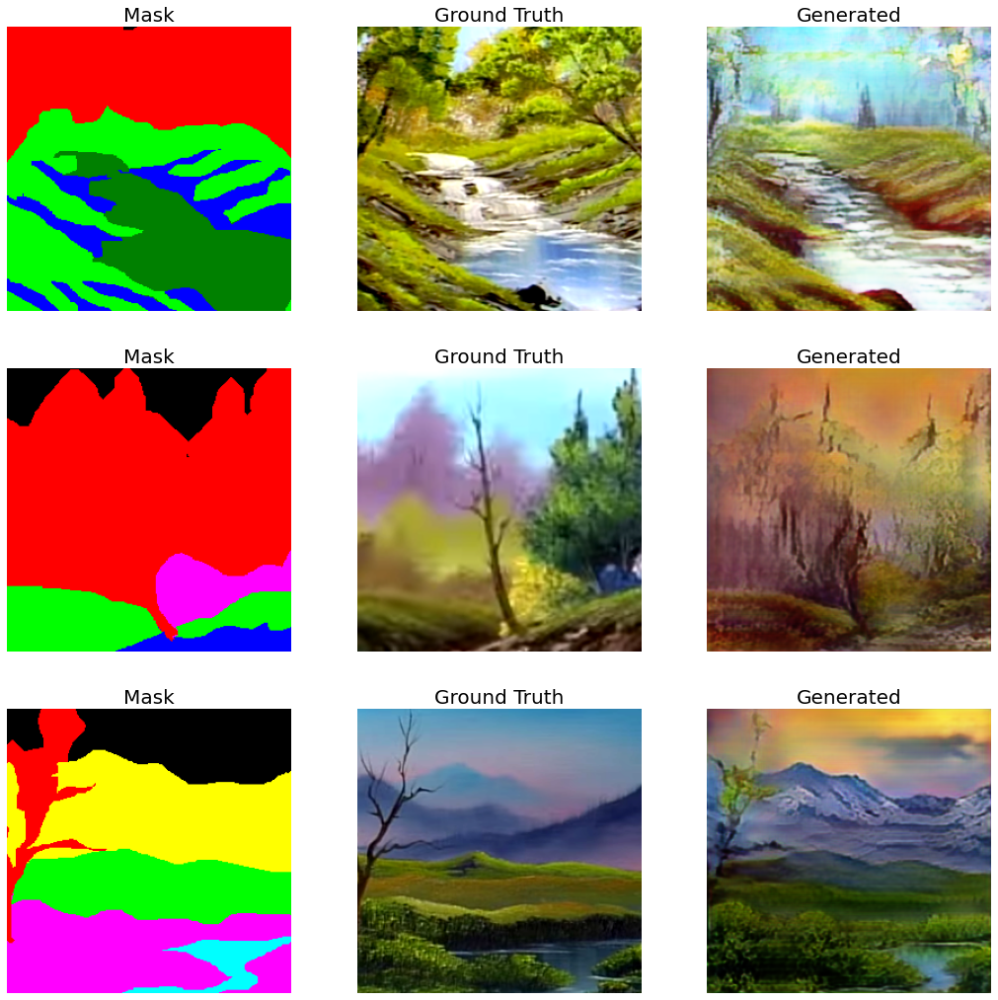

57/57 [==============================] - 23s 401ms/step - disc_loss: 0.6431 - gen_loss: 109.6982 - feat_loss: 7.8257 - vgg_loss: 14.6751 - kl_loss: 86.3127 - val_disc_loss: 0.7494 - val_gen_loss: 117.7908 - val_feat_loss: 11.1398 - val_vgg_loss: 18.8151 - val_kl_loss: 87.3593
Epoch 52/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6601 - gen_loss: 110.0339 - feat_loss: 7.8330 - vgg_loss: 14.7331 - kl_loss: 86.5984 - val_disc_loss: 0.7766 - val_gen_loss: 118.0480 - val_feat_loss: 10.9427 - val_vgg_loss: 19.0596 - val_kl_loss: 87.1831
Epoch 53/110
57/57 [==============================] - 22s 383ms/step - disc_loss: 0.6558 - gen_loss: 110.0579 - feat_loss: 7.9018 - vgg_loss: 14.7480 - kl_loss: 86.6277 - val_disc_loss: 0.8148 - val_gen_loss: 117.1294 - val_feat_loss: 11.5192 - val_vgg_loss: 18.5987 - val_kl_loss: 86.7623
Epoch 54/110
57/57 [==============================] - 22s 392ms/step - disc_loss: 0.6255 - gen_loss: 110.4685 - feat_loss: 7.7832 - vgg_loss: 1

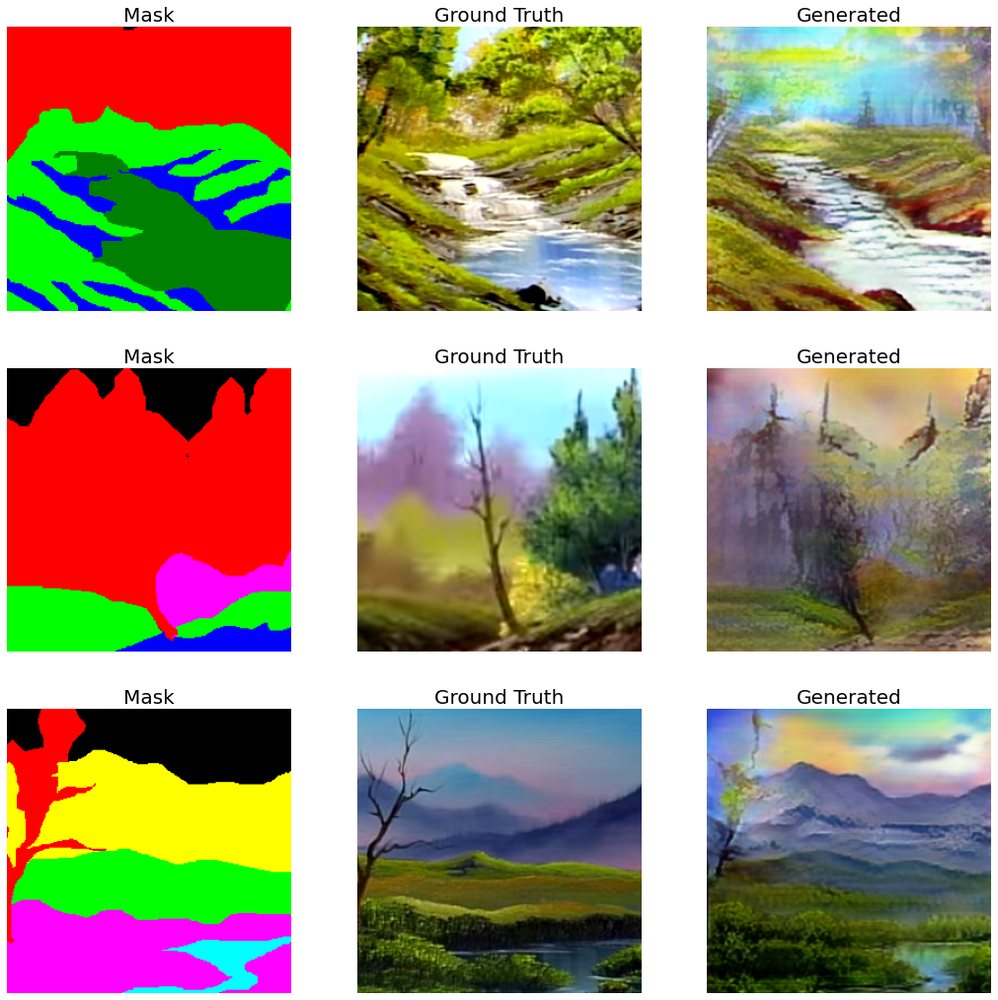

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6283 - gen_loss: 110.9900 - feat_loss: 7.8635 - vgg_loss: 14.6483 - kl_loss: 87.6502 - val_disc_loss: 0.7354 - val_gen_loss: 116.3456 - val_feat_loss: 11.1947 - val_vgg_loss: 18.7461 - val_kl_loss: 86.1938
Epoch 57/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6405 - gen_loss: 110.8606 - feat_loss: 7.8785 - vgg_loss: 14.8092 - kl_loss: 87.3211 - val_disc_loss: 0.8575 - val_gen_loss: 118.7208 - val_feat_loss: 11.3863 - val_vgg_loss: 18.9987 - val_kl_loss: 88.1665
Epoch 58/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6664 - gen_loss: 110.0393 - feat_loss: 7.9389 - vgg_loss: 14.7458 - kl_loss: 86.5404 - val_disc_loss: 0.9922 - val_gen_loss: 121.7277 - val_feat_loss: 11.4117 - val_vgg_loss: 19.1918 - val_kl_loss: 89.3839
Epoch 59/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6588 - gen_loss: 110.7772 - feat_loss: 7.8445 - vgg_loss: 1

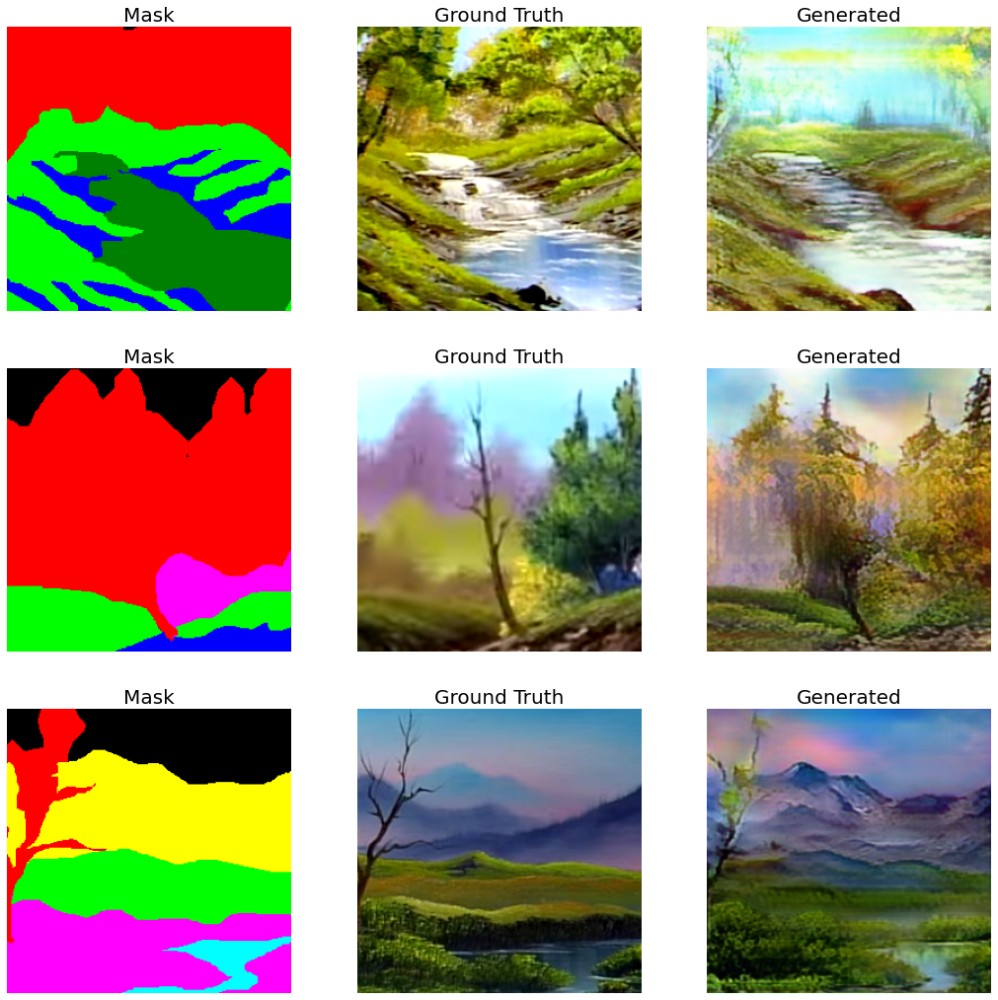

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6468 - gen_loss: 109.6975 - feat_loss: 7.8098 - vgg_loss: 14.6804 - kl_loss: 86.3661 - val_disc_loss: 0.9064 - val_gen_loss: 118.6157 - val_feat_loss: 10.9461 - val_vgg_loss: 19.0513 - val_kl_loss: 87.8111
Epoch 62/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6704 - gen_loss: 109.2849 - feat_loss: 7.8003 - vgg_loss: 14.6374 - kl_loss: 86.0666 - val_disc_loss: 0.6727 - val_gen_loss: 121.0958 - val_feat_loss: 10.9577 - val_vgg_loss: 19.0785 - val_kl_loss: 90.0924
Epoch 63/110
57/57 [==============================] - 22s 393ms/step - disc_loss: 0.6568 - gen_loss: 110.2824 - feat_loss: 7.6833 - vgg_loss: 14.5121 - kl_loss: 87.3392 - val_disc_loss: 0.7953 - val_gen_loss: 118.1454 - val_feat_loss: 10.9658 - val_vgg_loss: 18.8437 - val_kl_loss: 87.4485
Epoch 64/110
57/57 [==============================] - 22s 394ms/step - disc_loss: 0.6681 - gen_loss: 109.5468 - feat_loss: 7.7272 - vgg_loss: 1

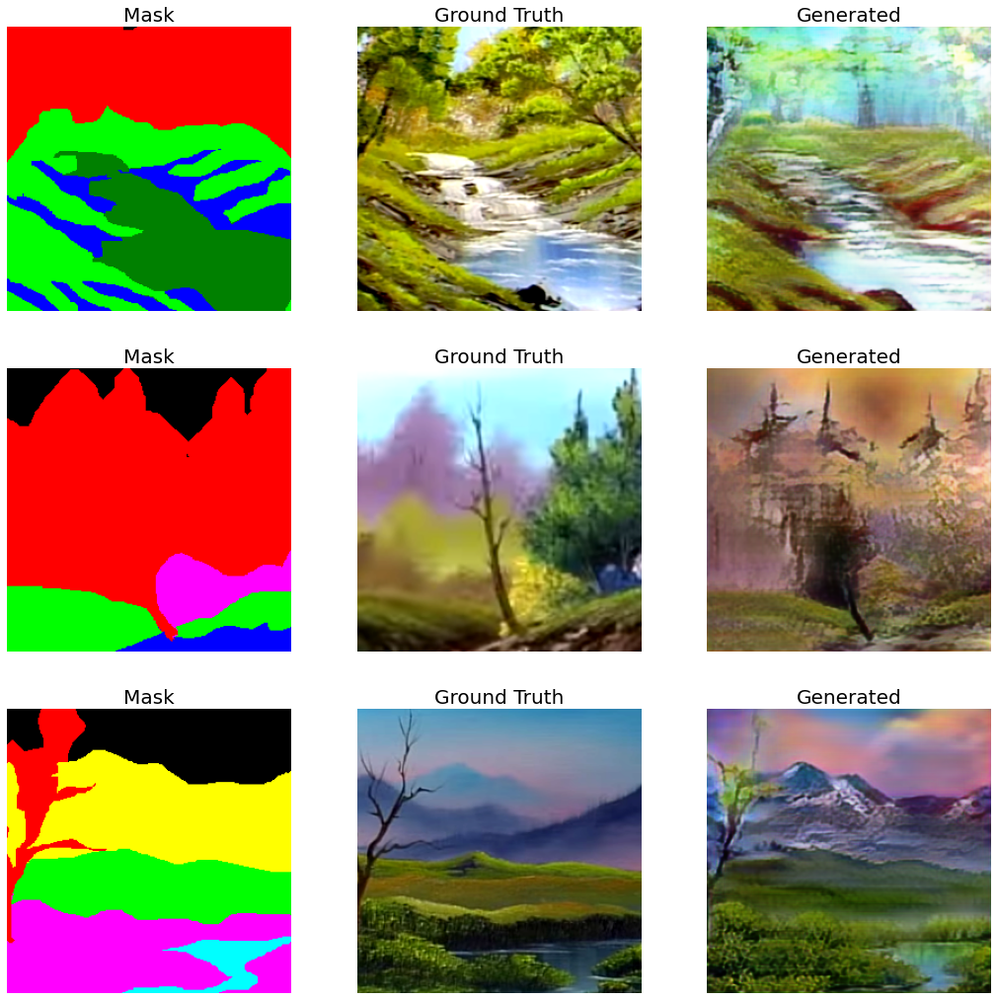

57/57 [==============================] - 23s 398ms/step - disc_loss: 0.6459 - gen_loss: 110.6926 - feat_loss: 7.7970 - vgg_loss: 14.5623 - kl_loss: 87.5188 - val_disc_loss: 0.8478 - val_gen_loss: 116.2787 - val_feat_loss: 11.0324 - val_vgg_loss: 18.6080 - val_kl_loss: 85.4541
Epoch 67/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6571 - gen_loss: 109.7738 - feat_loss: 7.6851 - vgg_loss: 14.5014 - kl_loss: 86.7974 - val_disc_loss: 0.7939 - val_gen_loss: 118.8687 - val_feat_loss: 11.0327 - val_vgg_loss: 19.0947 - val_kl_loss: 87.8623
Epoch 68/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6488 - gen_loss: 108.9688 - feat_loss: 7.7771 - vgg_loss: 14.4553 - kl_loss: 85.9258 - val_disc_loss: 0.8578 - val_gen_loss: 118.3465 - val_feat_loss: 11.0858 - val_vgg_loss: 19.1351 - val_kl_loss: 86.8863
Epoch 69/110
57/57 [==============================] - 22s 382ms/step - disc_loss: 0.6623 - gen_loss: 111.2950 - feat_loss: 7.7176 - vgg_loss: 1

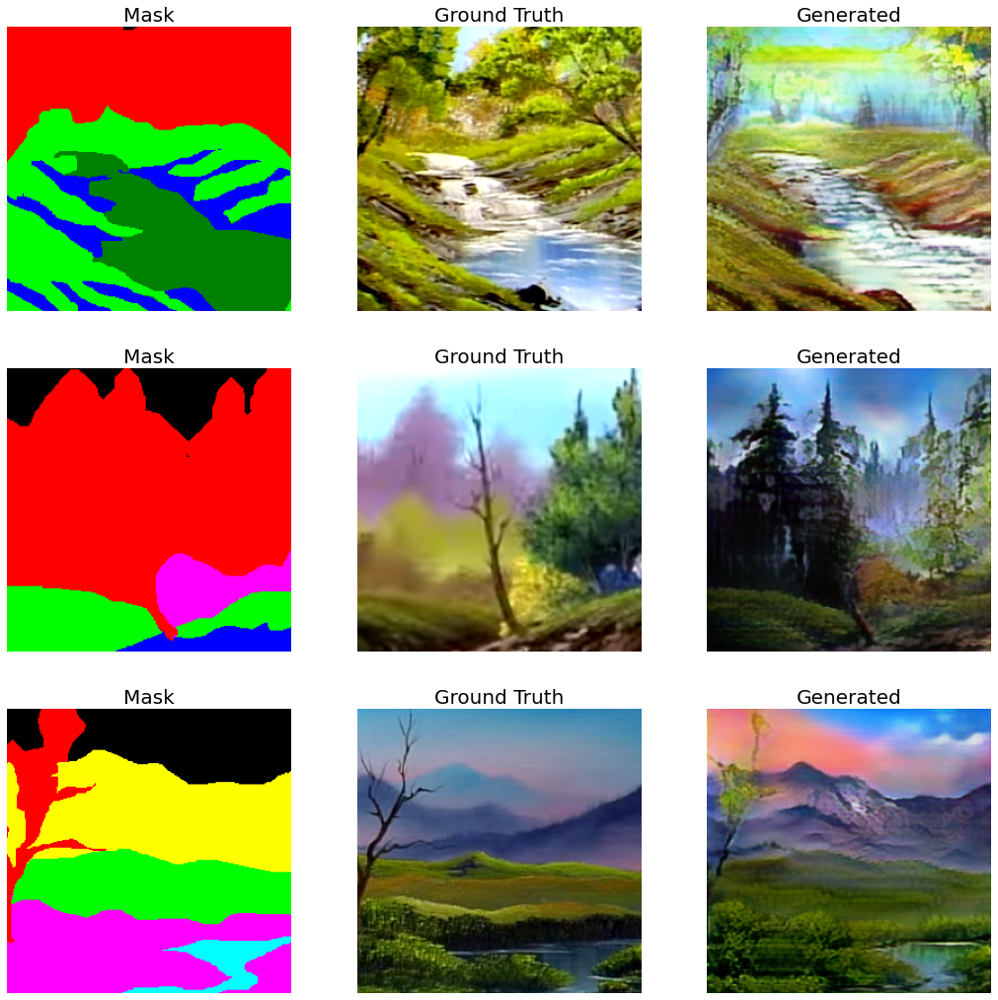

57/57 [==============================] - 23s 399ms/step - disc_loss: 0.6371 - gen_loss: 110.6098 - feat_loss: 7.7936 - vgg_loss: 14.5844 - kl_loss: 87.3949 - val_disc_loss: 0.8890 - val_gen_loss: 119.7472 - val_feat_loss: 11.2761 - val_vgg_loss: 19.4641 - val_kl_loss: 87.5945
Epoch 72/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6411 - gen_loss: 109.4247 - feat_loss: 7.6786 - vgg_loss: 14.4031 - kl_loss: 86.5174 - val_disc_loss: 0.9852 - val_gen_loss: 118.3946 - val_feat_loss: 11.2457 - val_vgg_loss: 19.3252 - val_kl_loss: 86.6865
Epoch 73/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6824 - gen_loss: 110.0731 - feat_loss: 7.7075 - vgg_loss: 14.5130 - kl_loss: 87.0518 - val_disc_loss: 0.9154 - val_gen_loss: 118.6923 - val_feat_loss: 11.2063 - val_vgg_loss: 19.2996 - val_kl_loss: 87.7404
Epoch 74/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6440 - gen_loss: 110.2685 - feat_loss: 7.6585 - vgg_loss: 1

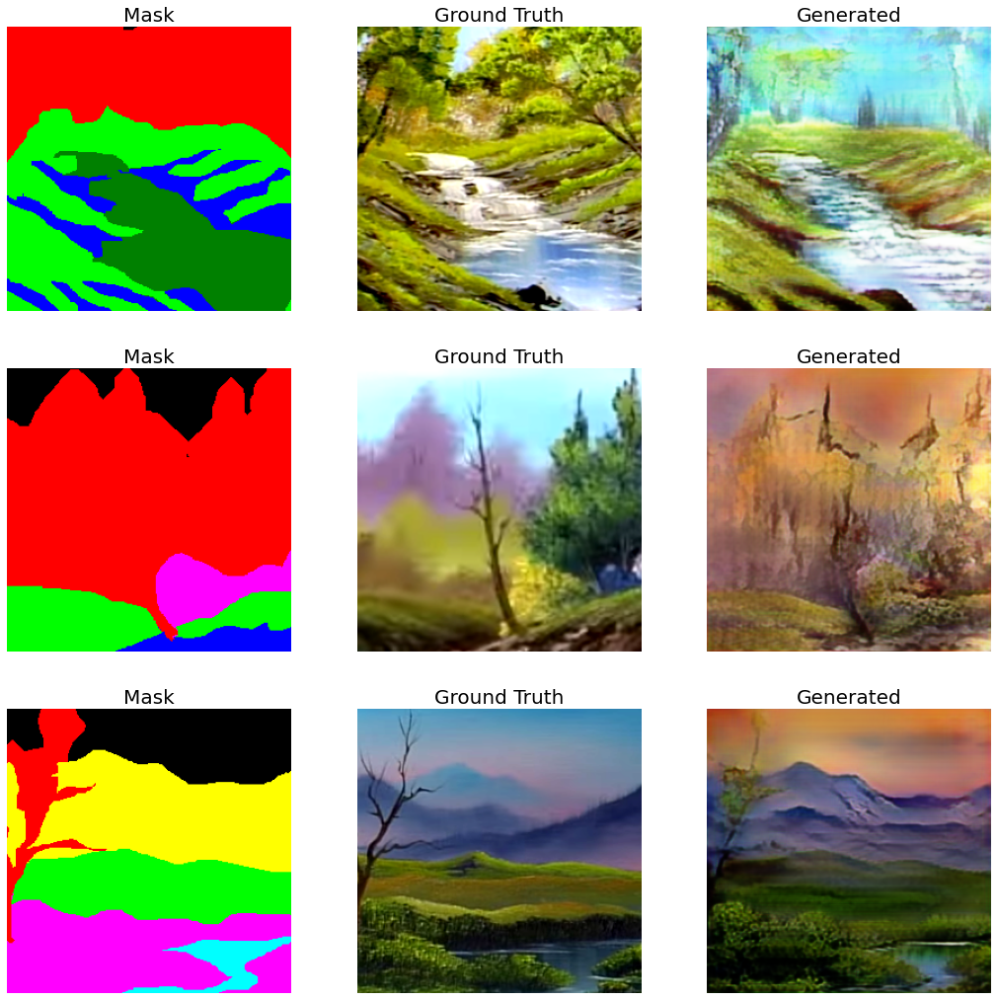

57/57 [==============================] - 23s 395ms/step - disc_loss: 0.6623 - gen_loss: 110.1042 - feat_loss: 7.6045 - vgg_loss: 14.3617 - kl_loss: 87.3741 - val_disc_loss: 0.9100 - val_gen_loss: 118.9865 - val_feat_loss: 10.9340 - val_vgg_loss: 18.5448 - val_kl_loss: 88.7332
Epoch 77/110
57/57 [==============================] - 22s 382ms/step - disc_loss: 0.6640 - gen_loss: 109.6346 - feat_loss: 7.6716 - vgg_loss: 14.3962 - kl_loss: 86.7794 - val_disc_loss: 0.9249 - val_gen_loss: 120.6614 - val_feat_loss: 11.2608 - val_vgg_loss: 19.0507 - val_kl_loss: 89.8401
Epoch 78/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6741 - gen_loss: 110.3140 - feat_loss: 7.6418 - vgg_loss: 14.4862 - kl_loss: 87.4155 - val_disc_loss: 0.8918 - val_gen_loss: 117.5461 - val_feat_loss: 10.8571 - val_vgg_loss: 18.8368 - val_kl_loss: 86.3543
Epoch 79/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6405 - gen_loss: 110.1410 - feat_loss: 7.6500 - vgg_loss: 1

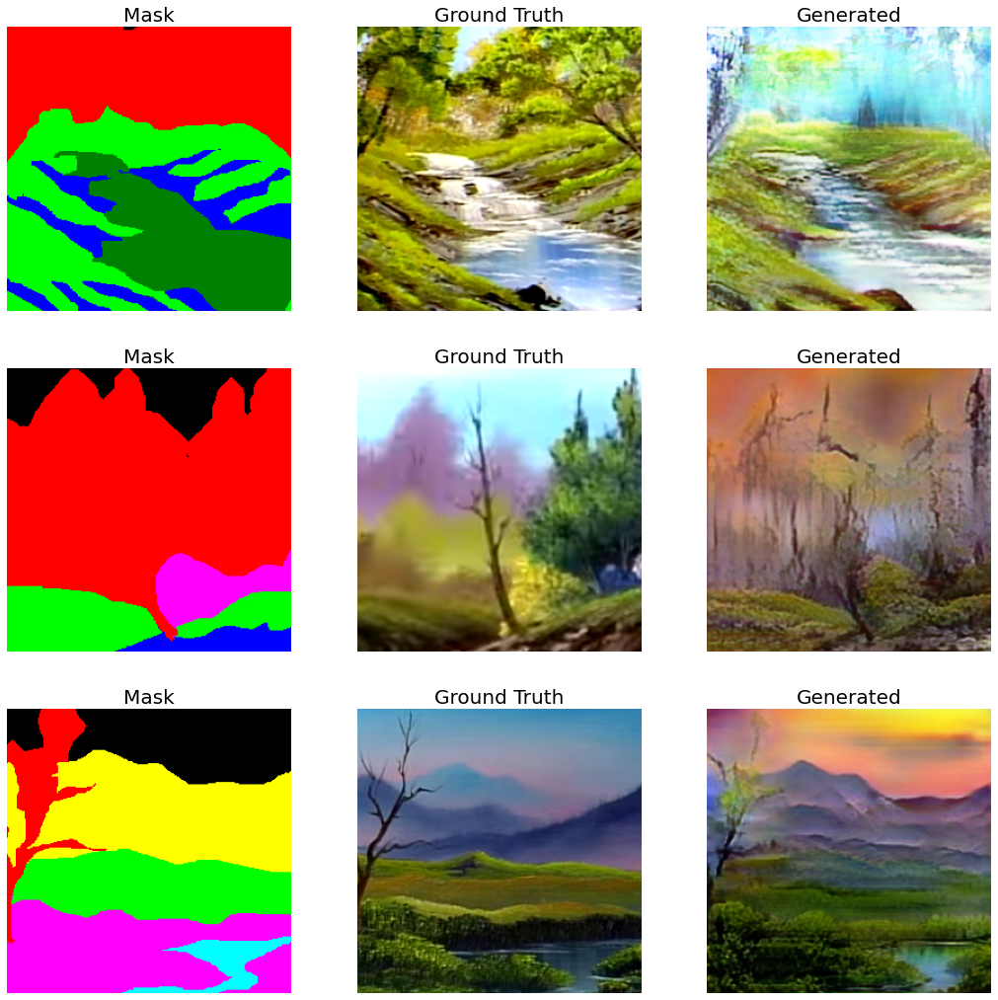

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6404 - gen_loss: 109.5391 - feat_loss: 7.6550 - vgg_loss: 14.2951 - kl_loss: 86.7733 - val_disc_loss: 0.8218 - val_gen_loss: 118.0406 - val_feat_loss: 11.2809 - val_vgg_loss: 19.3011 - val_kl_loss: 86.6173
Epoch 82/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6517 - gen_loss: 109.9334 - feat_loss: 7.6601 - vgg_loss: 14.3621 - kl_loss: 87.1073 - val_disc_loss: 0.8393 - val_gen_loss: 117.0717 - val_feat_loss: 11.0250 - val_vgg_loss: 18.6845 - val_kl_loss: 85.8632
Epoch 83/110
57/57 [==============================] - 22s 393ms/step - disc_loss: 0.6647 - gen_loss: 110.1142 - feat_loss: 7.7307 - vgg_loss: 14.5791 - kl_loss: 87.0384 - val_disc_loss: 0.8736 - val_gen_loss: 119.4382 - val_feat_loss: 11.1719 - val_vgg_loss: 19.2698 - val_kl_loss: 88.5579
Epoch 84/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6488 - gen_loss: 110.6586 - feat_loss: 7.5728 - vgg_loss: 1

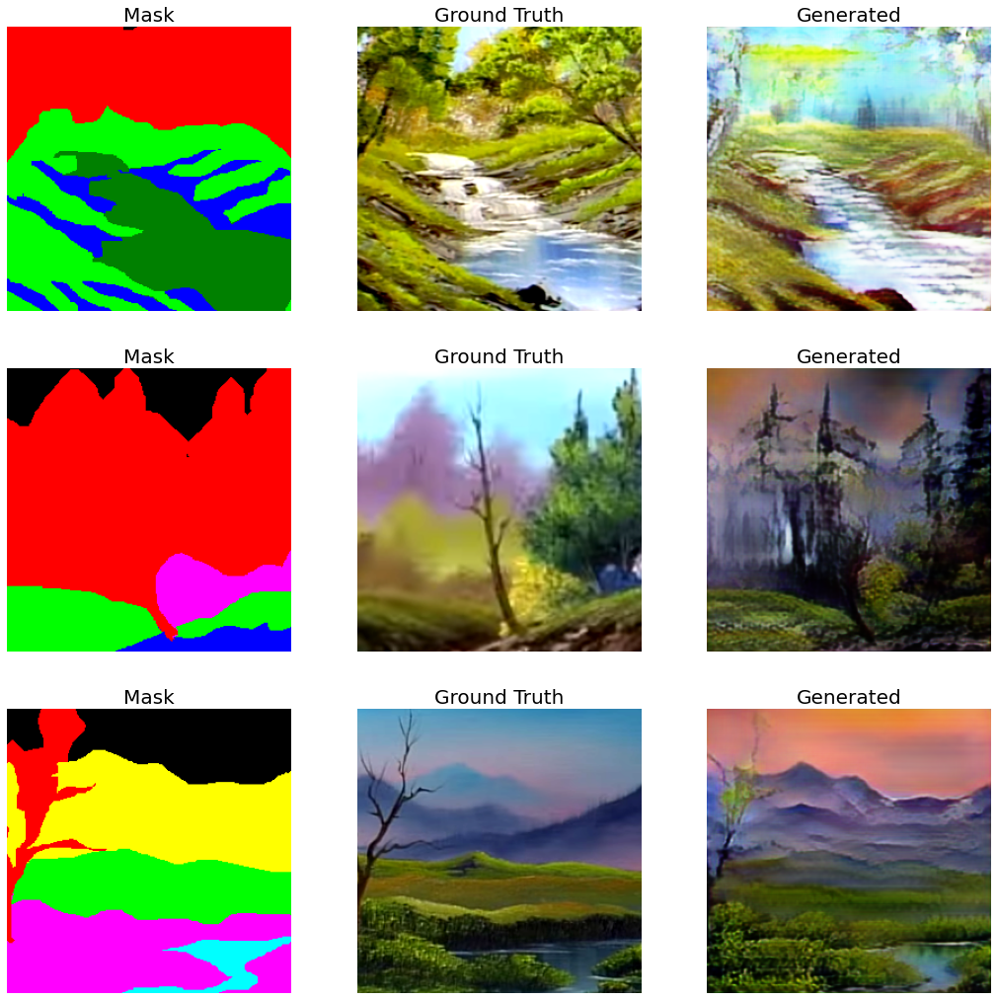

57/57 [==============================] - 23s 399ms/step - disc_loss: 0.6386 - gen_loss: 109.5362 - feat_loss: 7.6792 - vgg_loss: 14.3452 - kl_loss: 86.6957 - val_disc_loss: 0.7844 - val_gen_loss: 123.5039 - val_feat_loss: 11.4338 - val_vgg_loss: 19.2931 - val_kl_loss: 92.2875
Epoch 87/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6741 - gen_loss: 110.3079 - feat_loss: 7.5944 - vgg_loss: 14.3259 - kl_loss: 87.6139 - val_disc_loss: 0.7611 - val_gen_loss: 118.6432 - val_feat_loss: 11.1864 - val_vgg_loss: 19.1529 - val_kl_loss: 87.0449
Epoch 88/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6576 - gen_loss: 110.1108 - feat_loss: 7.6207 - vgg_loss: 14.2988 - kl_loss: 87.3998 - val_disc_loss: 0.7212 - val_gen_loss: 118.8073 - val_feat_loss: 10.8861 - val_vgg_loss: 18.5746 - val_kl_loss: 88.2724
Epoch 89/110
57/57 [==============================] - 22s 381ms/step - disc_loss: 0.6466 - gen_loss: 109.9762 - feat_loss: 7.6202 - vgg_loss: 1

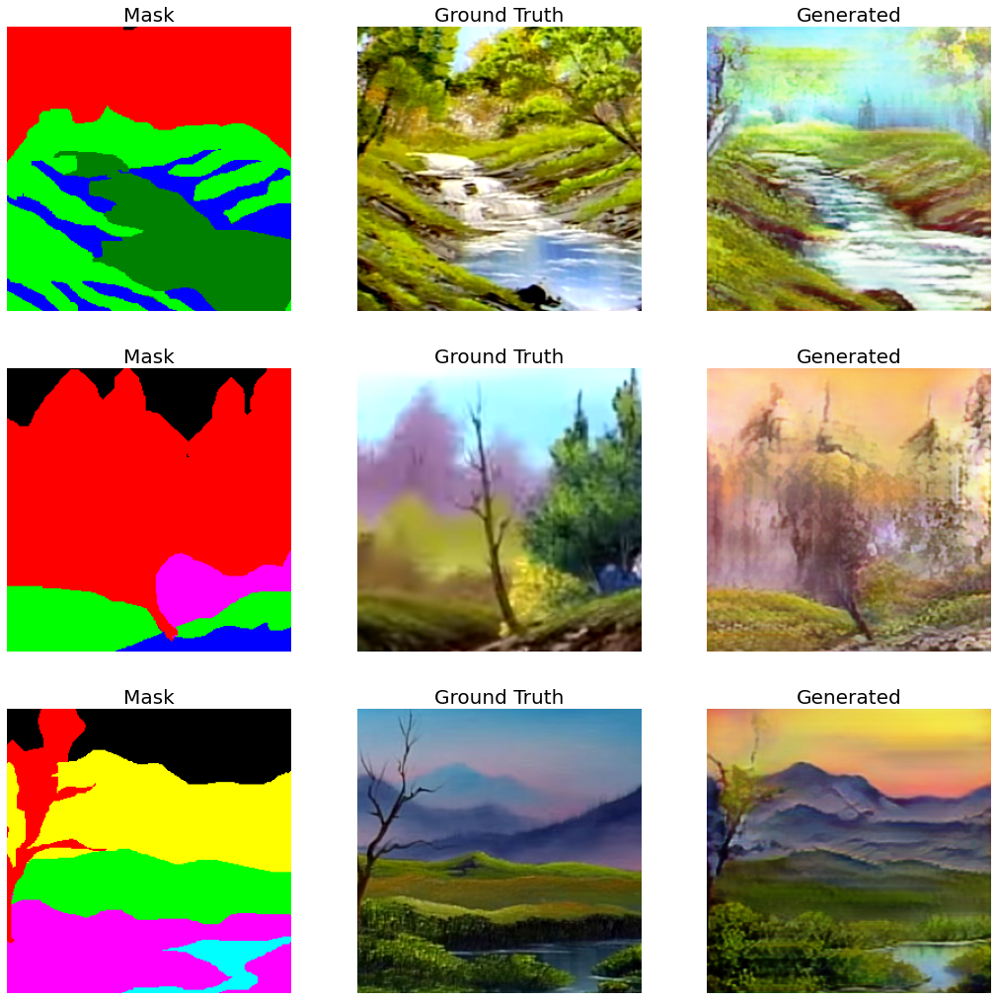

57/57 [==============================] - 24s 415ms/step - disc_loss: 0.6886 - gen_loss: 110.4468 - feat_loss: 7.6736 - vgg_loss: 14.4813 - kl_loss: 87.5257 - val_disc_loss: 1.0095 - val_gen_loss: 119.8671 - val_feat_loss: 11.1128 - val_vgg_loss: 19.3856 - val_kl_loss: 89.0486
Epoch 92/110
57/57 [==============================] - 22s 386ms/step - disc_loss: 0.6766 - gen_loss: 109.8057 - feat_loss: 7.6000 - vgg_loss: 14.2443 - kl_loss: 87.1893 - val_disc_loss: 0.7936 - val_gen_loss: 118.0938 - val_feat_loss: 11.0305 - val_vgg_loss: 18.8528 - val_kl_loss: 87.8886
Epoch 93/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6852 - gen_loss: 110.3545 - feat_loss: 7.6434 - vgg_loss: 14.4107 - kl_loss: 87.5411 - val_disc_loss: 0.8532 - val_gen_loss: 119.2965 - val_feat_loss: 11.2756 - val_vgg_loss: 18.6663 - val_kl_loss: 89.3378
Epoch 94/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6383 - gen_loss: 110.2072 - feat_loss: 7.6484 - vgg_loss: 1

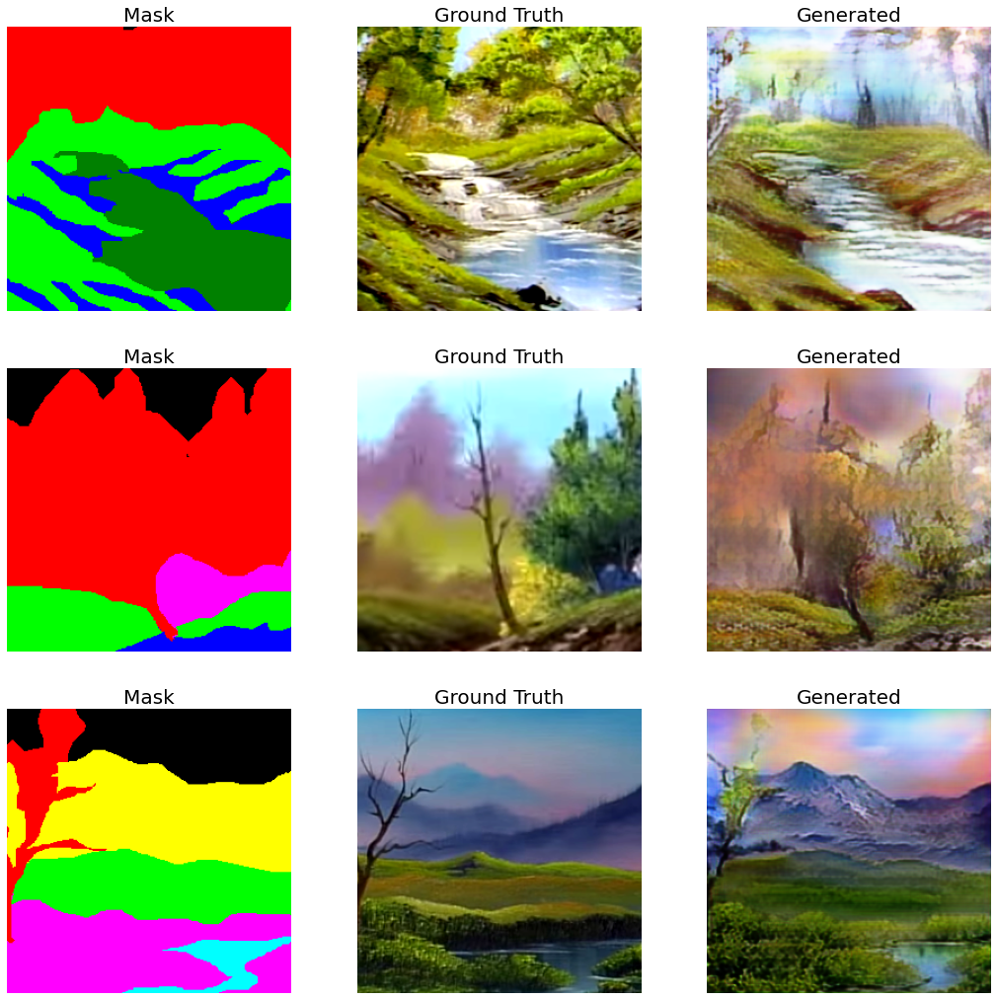

57/57 [==============================] - 23s 400ms/step - disc_loss: 0.6745 - gen_loss: 109.2641 - feat_loss: 7.6307 - vgg_loss: 14.3246 - kl_loss: 86.5056 - val_disc_loss: 0.8668 - val_gen_loss: 118.1768 - val_feat_loss: 11.1316 - val_vgg_loss: 18.7276 - val_kl_loss: 87.7948
Epoch 97/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6526 - gen_loss: 110.1475 - feat_loss: 7.5796 - vgg_loss: 14.2815 - kl_loss: 87.4487 - val_disc_loss: 0.9051 - val_gen_loss: 120.0746 - val_feat_loss: 11.2666 - val_vgg_loss: 18.8887 - val_kl_loss: 88.3086
Epoch 98/110
57/57 [==============================] - 22s 387ms/step - disc_loss: 0.6796 - gen_loss: 109.4816 - feat_loss: 7.5307 - vgg_loss: 14.1560 - kl_loss: 87.0689 - val_disc_loss: 0.9257 - val_gen_loss: 120.0287 - val_feat_loss: 11.0146 - val_vgg_loss: 18.9152 - val_kl_loss: 89.0533
Epoch 99/110
57/57 [==============================] - 22s 388ms/step - disc_loss: 0.6529 - gen_loss: 110.2958 - feat_loss: 7.7932 - vgg_loss: 1

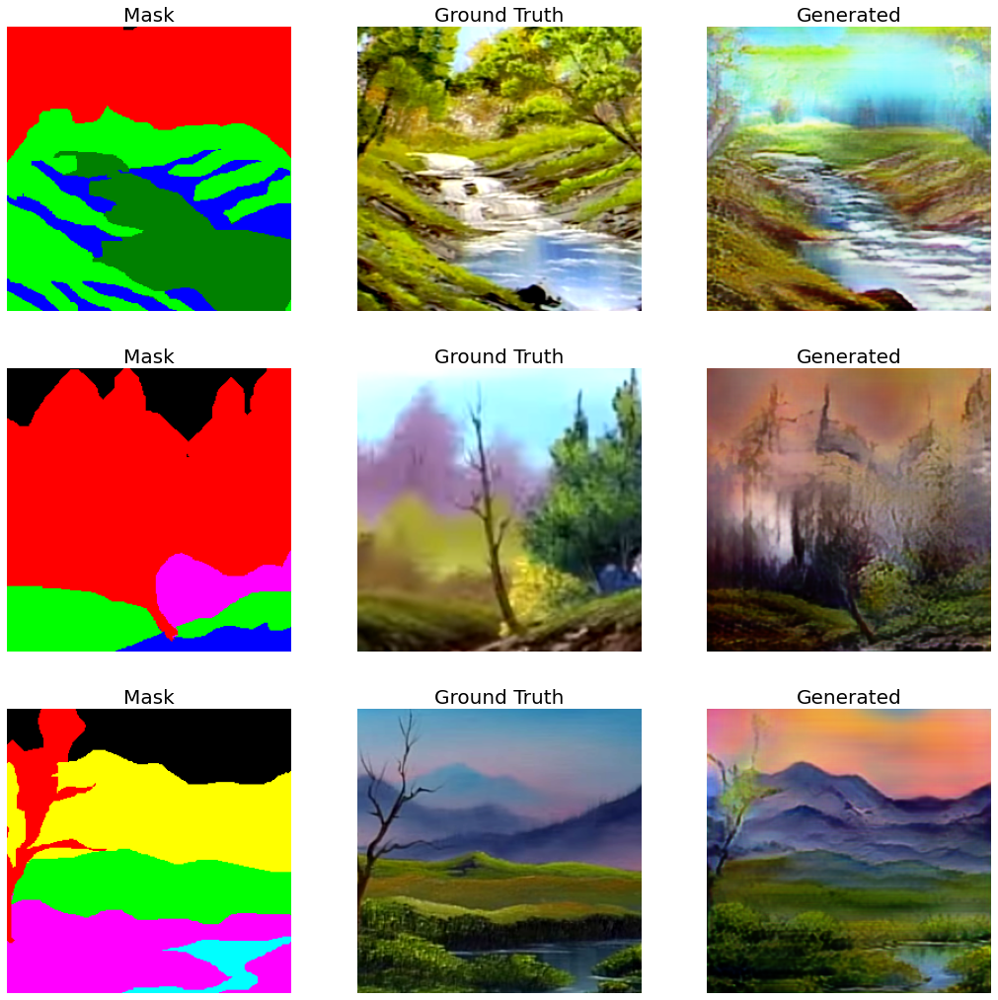

57/57 [==============================] - 25s 437ms/step - disc_loss: 0.6641 - gen_loss: 109.7955 - feat_loss: 7.5612 - vgg_loss: 14.1721 - kl_loss: 87.2805 - val_disc_loss: 0.8422 - val_gen_loss: 119.5382 - val_feat_loss: 11.1372 - val_vgg_loss: 19.1434 - val_kl_loss: 88.2464
Epoch 102/110
40/57 [====================>.........] - ETA: 6s - disc_loss: 0.6565 - gen_loss: 109.8809 - feat_loss: 7.7091 - vgg_loss: 14.4363 - kl_loss: 86.9569

In [ ]:
history = gaugan.fit(
    train_dataset,
    validation_data=test_dataset,
    epochs=110,
    callbacks=[GanMonitor(test_dataset, BATCH_SIZE), GanCheckpoint(epoch_interval=100)],
)


def plot_history(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=14)
    plt.legend()
    plt.grid()
    plt.show()


plot_history("disc_loss")
plot_history("gen_loss")
plot_history("feat_loss")
plot_history("vgg_loss")
plot_history("kl_loss")